In [ ]:
# !git clone https://github.com/parthv21/VOC-Semantic-Segmentation.git
# !rm ./VOC-Semantic-Segmentation/main.ipynb
# !mv ./VOC-Semantic-Segmentation/* .
# !rm -rf VOC-Semantic-Segmentation

Cloning into 'VOC-Semantic-Segmentation'...
remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 187 (delta 0), reused 4 (delta 0), pack-reused 180
Receiving objects: 100% (187/187), 714.09 MiB | 43.88 MiB/s, done.
Resolving deltas: 100% (90/90), done.
Checking out files: 100% (30/30), done.


In [ ]:
# !cd model/
# !cd model
# !find . -type f -iname \*.log -delete

In [ ]:
from voc12 import VOC2012
import numpy as np
from numpy import array
import matplotlib.pyplot as plt
import random
import pathlib
import torch

from model.Naive import Naive
from model.Skip import Skip
from model.FCN import FCN
from model.FCN8 import FCN8

from train import train, predict
from utils.visualization import visualizePrediction
from criterion.CrossEntropy import getCrossEntropyLoss



In [ ]:
# !wget https://s3.amazonaws.com/fast-ai-imagelocal/pascal-voc.tgz 
# !tar -xzf ./pascal-voc.tgz
# !rm -rf ./pascal-voc/VOC2007
# !rm ./pascal-voc.tgz

--2020-11-19 02:36:54--  https://s3.amazonaws.com/fast-ai-imagelocal/pascal-voc.tgz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.39.222
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.39.222|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4639722845 (4.3G) [application/x-tar]
Saving to: ‘pascal-voc.tgz’

pascal-voc.tgz      100%[===================>]   4.32G  35.2MB/s    in 2m 7s   

2020-11-19 02:39:02 (34.8 MB/s) - ‘pascal-voc.tgz’ saved [4639722845/4639722845]



In [ ]:
naive = train(model_name="naive", criterionType="ce", num_epochs=200, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)


Model Architecture to be Trained: 
Naive(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): LeakyReLU(negative_slope=0.01)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout2d(p=0.5, inplace=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.01)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): Dropout2d(p=0.5, inplace=False)
    (12): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  )
  (decorder): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1)

In [ ]:
voc2012 = VOC2012('./pascal-voc/VOC2012/')

ptrain = pathlib.Path('./voc2012_train.h5')
pval = pathlib.Path('./voc2012_val.h5')

if ptrain.is_file() and pval.is_file():
    voc2012.load_all_data()
else:
    voc2012.read_all_data_and_save()

loading ./voc2012_train.h5
loading ./voc2012_val.h5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


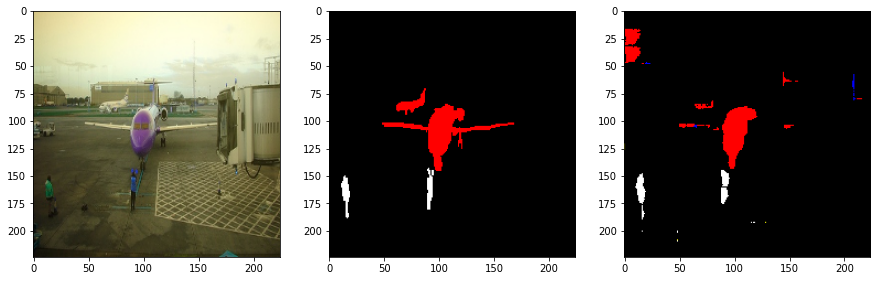

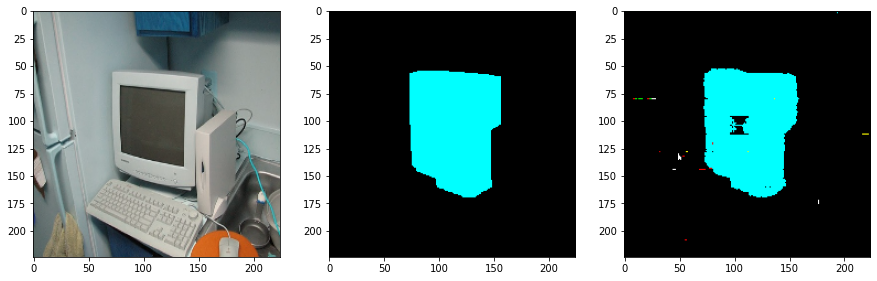

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


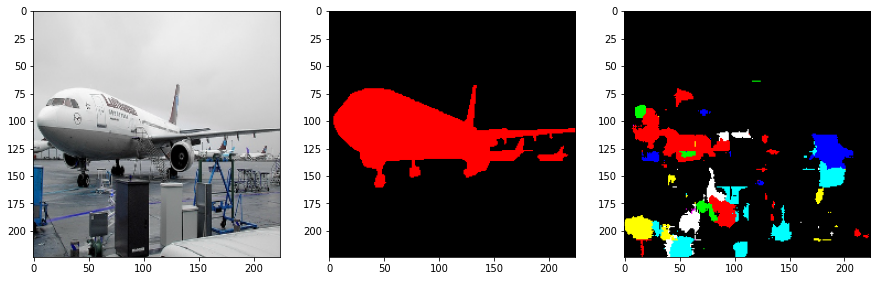

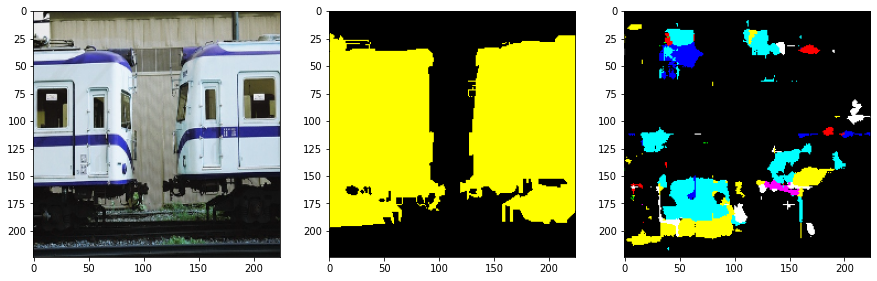

In [ ]:
ind = range(0,2)
visualizePrediction(naive, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(naive, voc2012.val_images[ind], voc2012.val_labels[ind])



Model Architecture to be Trained: 
Naive(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): LeakyReLU(negative_slope=0.01)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout2d(p=0.5, inplace=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.01)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): Dropout2d(p=0.5, inplace=False)
    (12): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  )
  (decorder): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:200, Loss:0.0830 Val set: Average loss: 0.1165, Accuracy: 34666/50176 (69%)
Training time:  446252:06:47.60


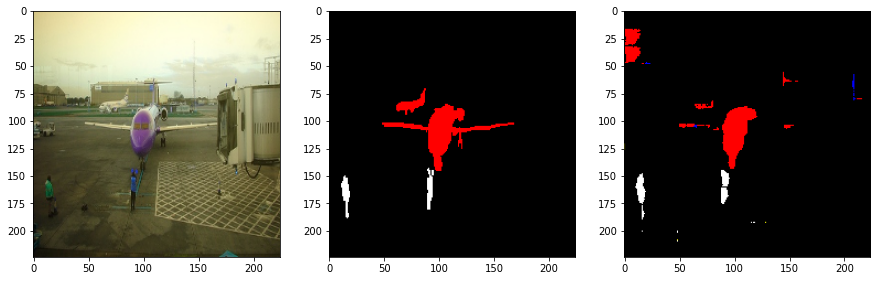

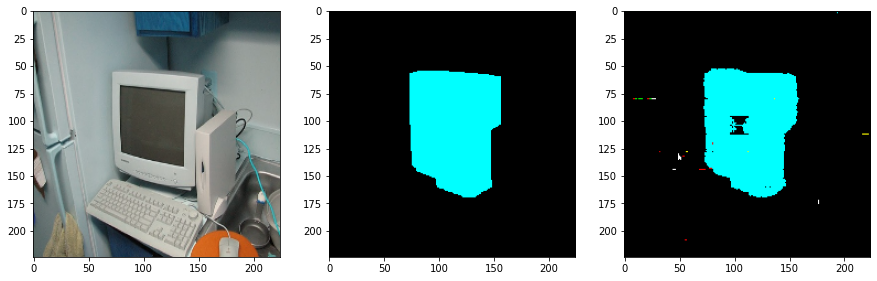

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


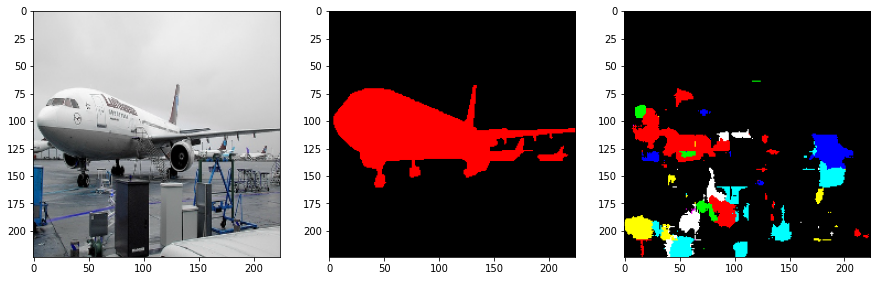

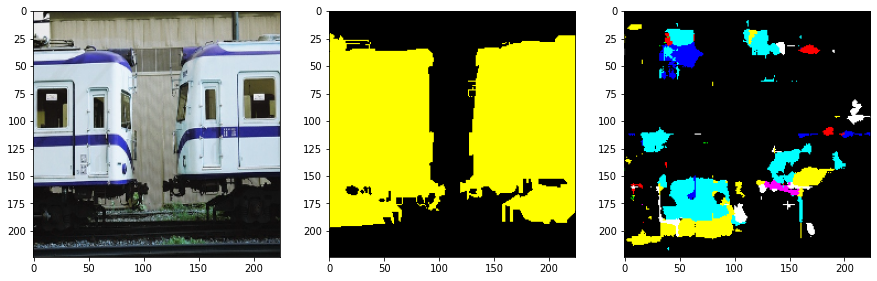

In [ ]:
naive_weighted = train(model_name="naive", criterionType="ce", weighted=True, num_epochs=200, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)
ind = range(0,2)
visualizePrediction(naive, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(naive, voc2012.val_images[ind], voc2012.val_labels[ind])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


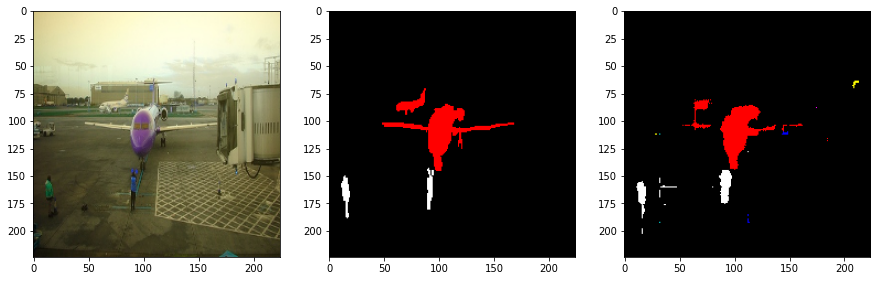

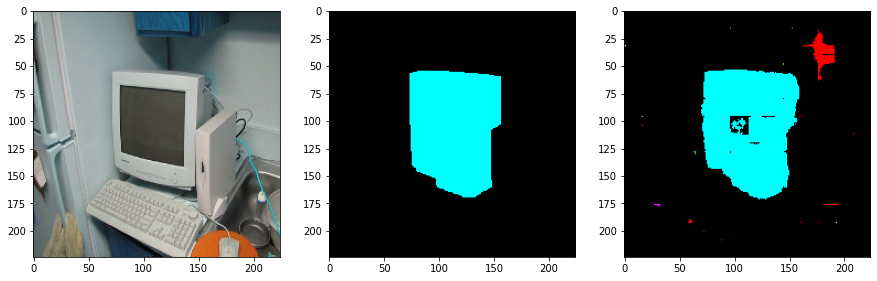

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


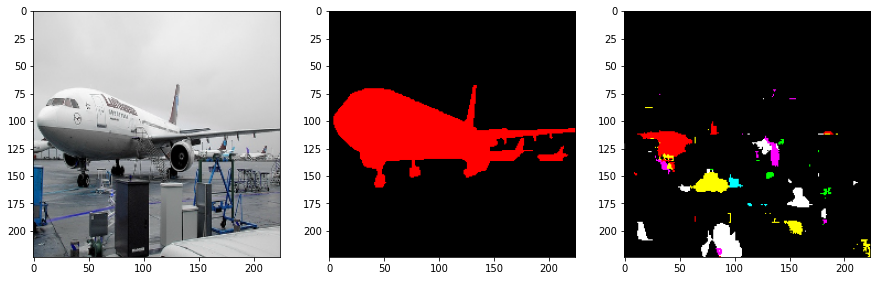

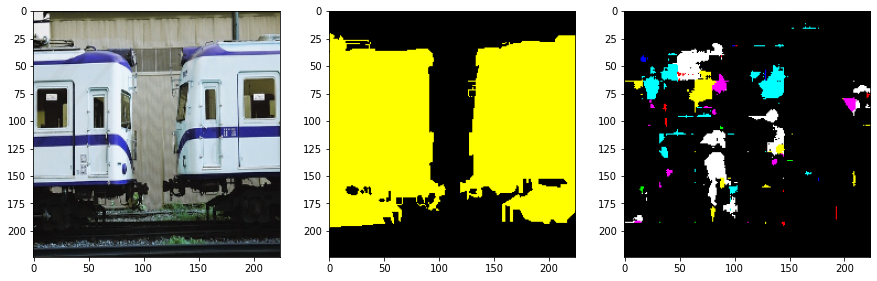

In [ ]:
visualizePrediction(naive_weighted, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(naive_weighted, voc2012.val_images[ind], voc2012.val_labels[ind])

Model Architecture to be Trained: 
Naive(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): LeakyReLU(negative_slope=0.01)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout2d(p=0.5, inplace=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.01)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): Dropout2d(p=0.5, inplace=False)
    (12): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  )
  (decorder): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:200, Loss:0.1293 Val set: Average loss: 0.1125, Accuracy: 2852/50176 (6%)
Training time:  446252:40:54.59


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


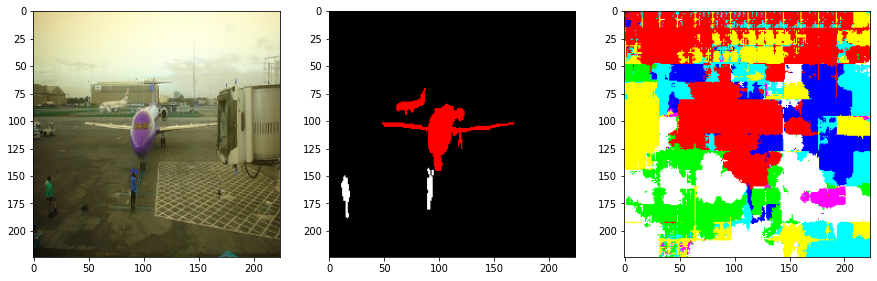

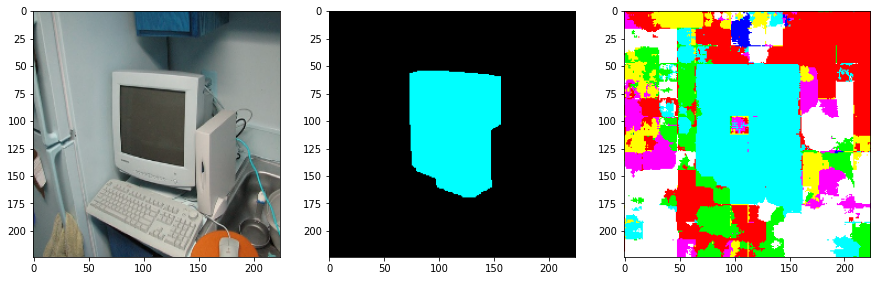

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


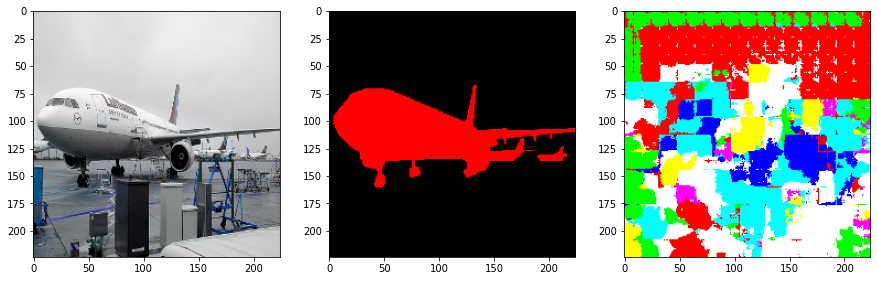

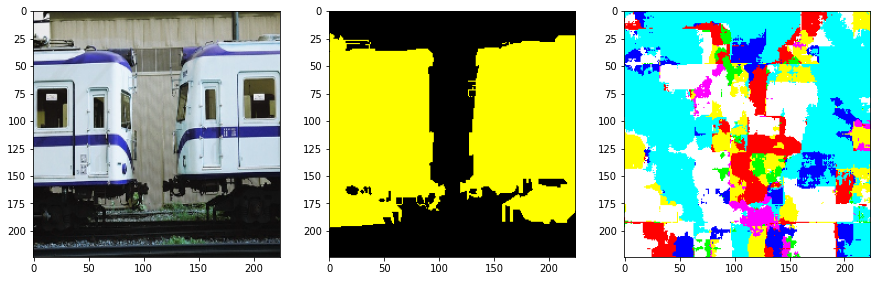

In [ ]:
naive_ignore = train(model_name="naive", criterionType="ce", ignore=True, num_epochs=200, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)
ind = range(0,2)
visualizePrediction(naive_ignore, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(naive_ignore, voc2012.val_images[ind], voc2012.val_labels[ind])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

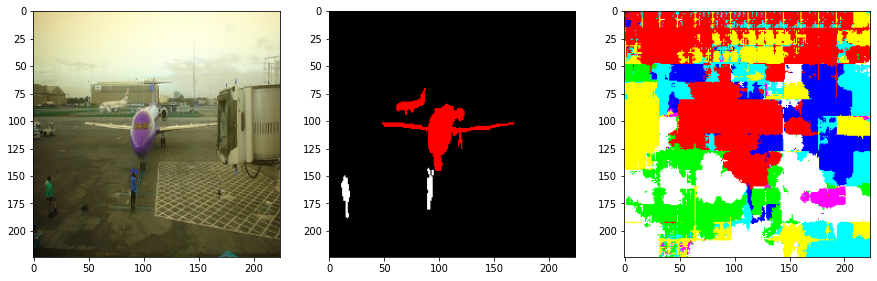

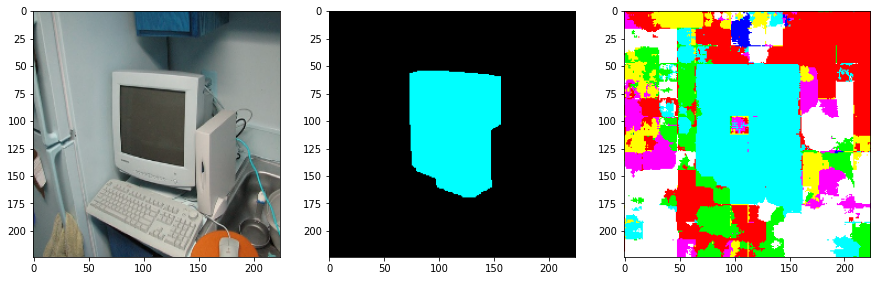

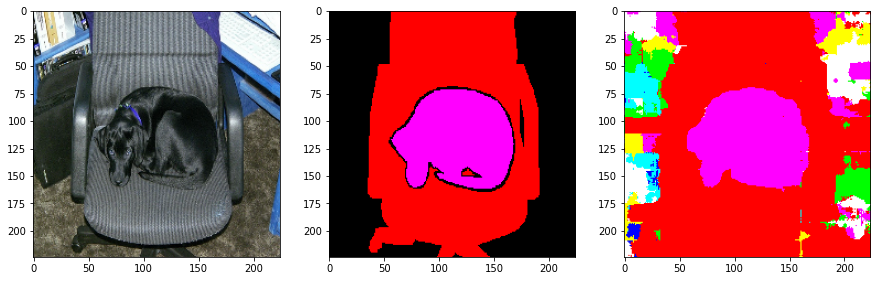

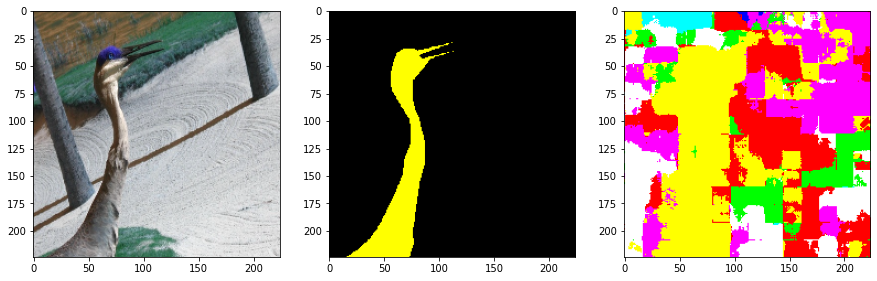

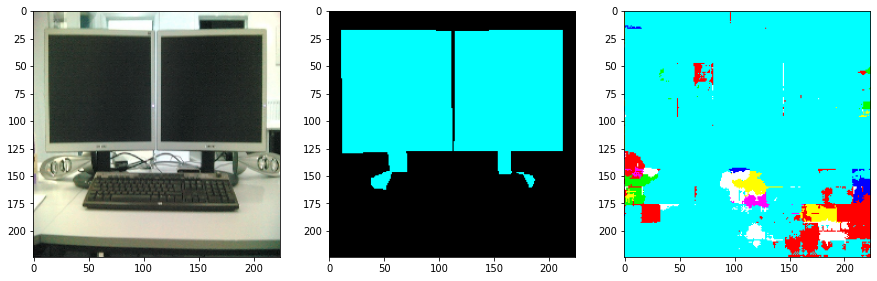

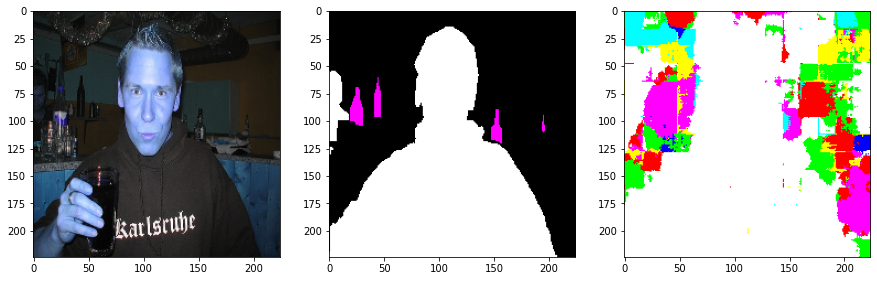

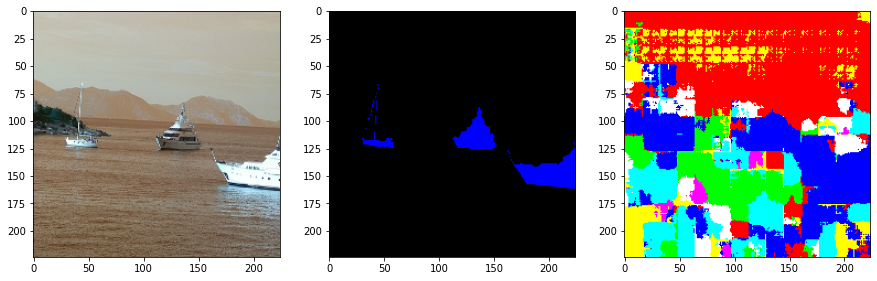

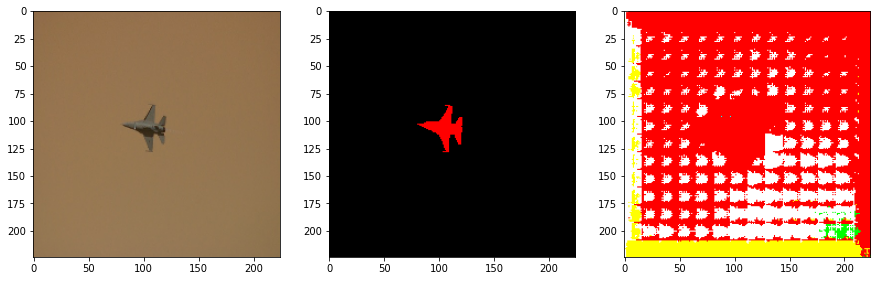

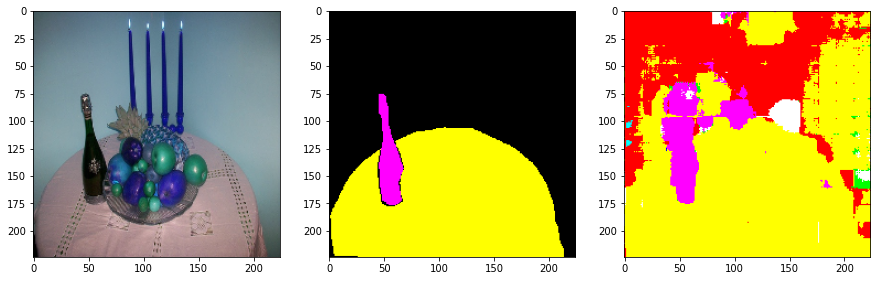

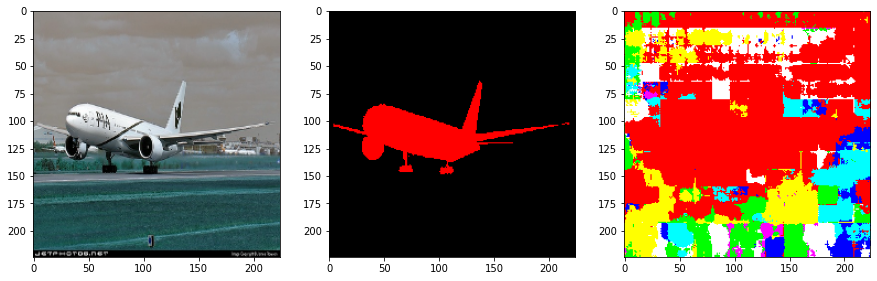

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

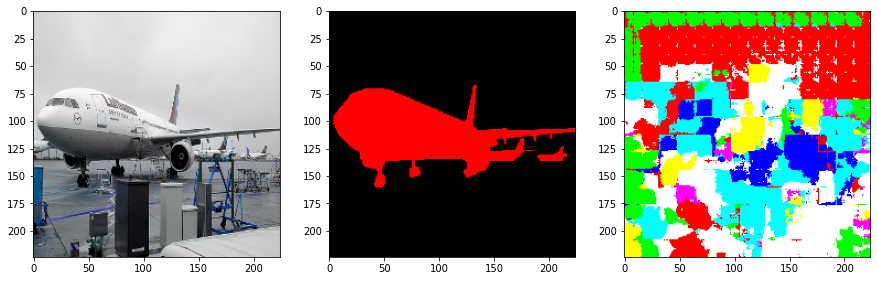

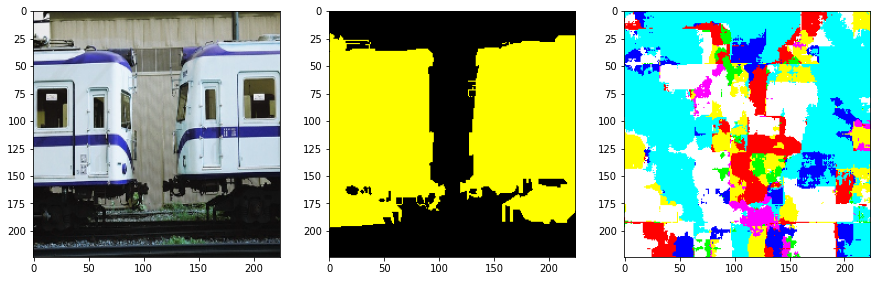

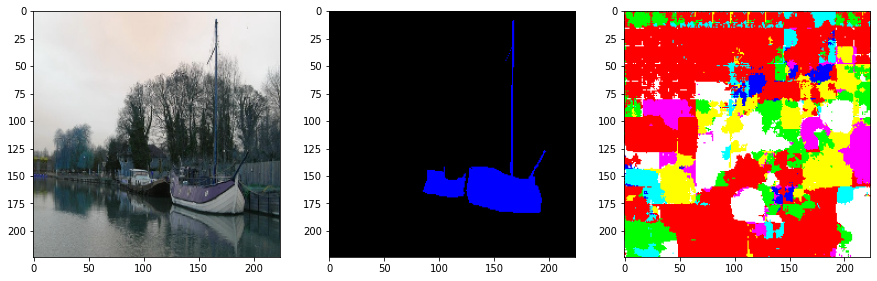

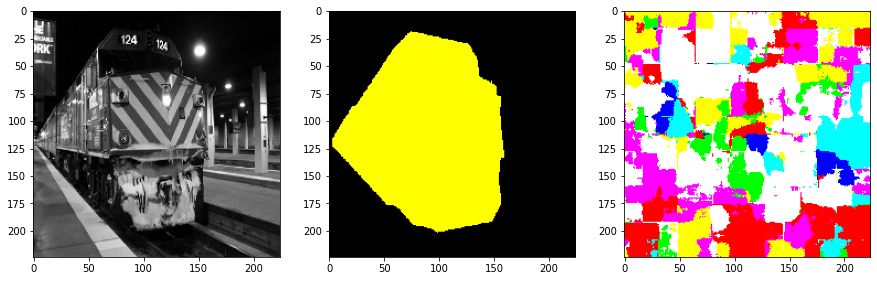

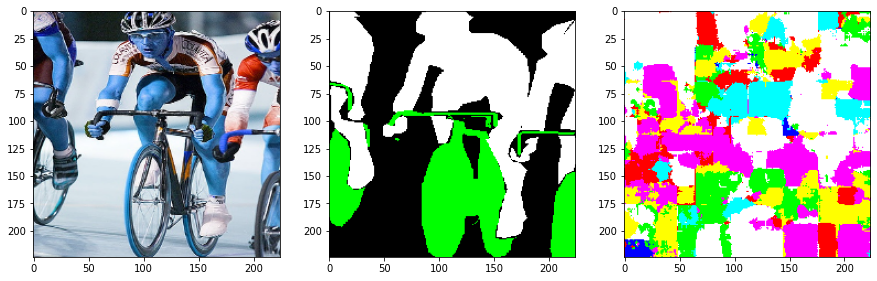

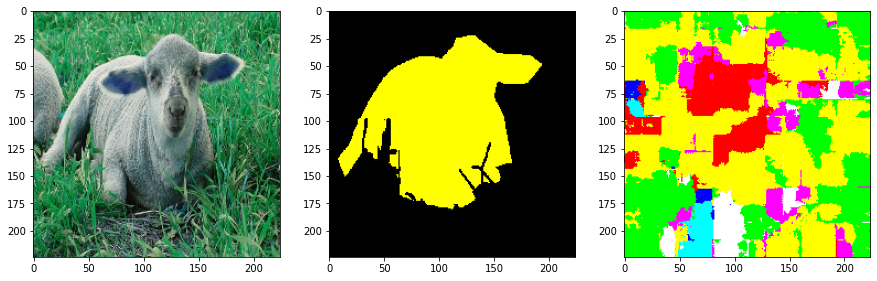

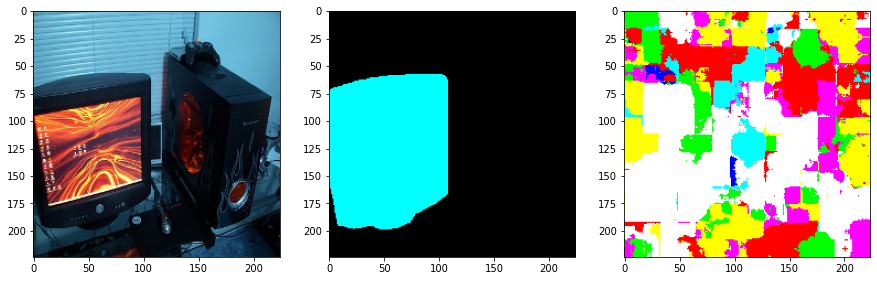

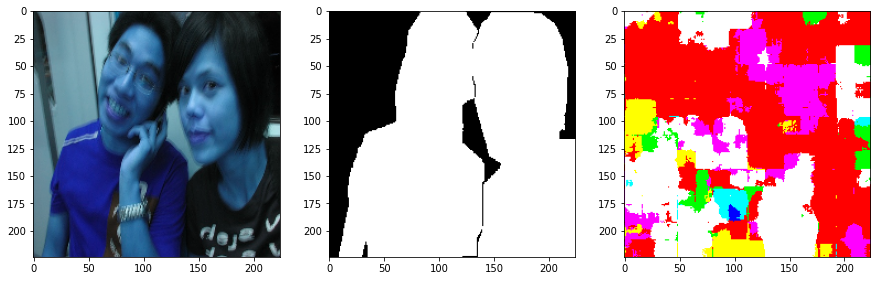

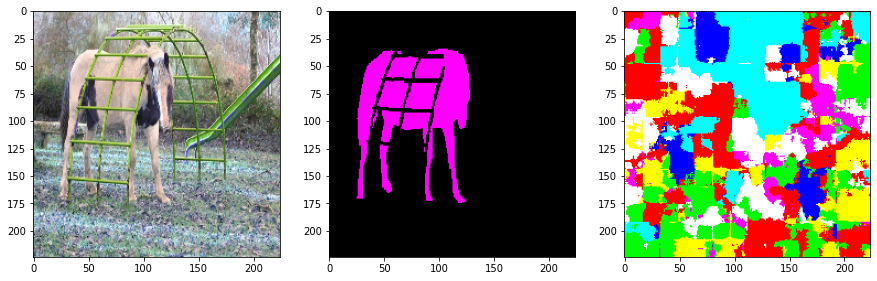

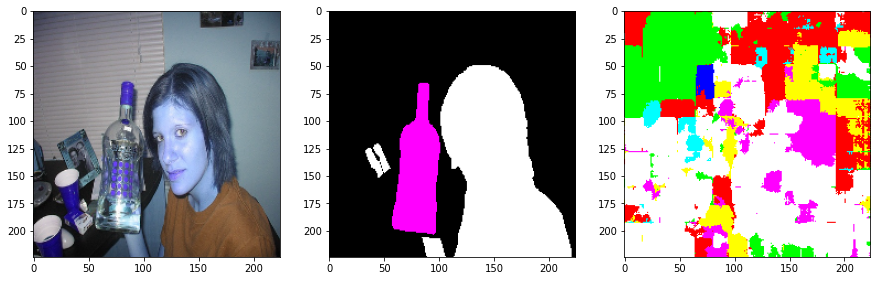

In [ ]:
ind = range(0,10)
visualizePrediction(naive_ignore, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(naive_ignore, voc2012.val_images[ind], voc2012.val_labels[ind])

Model Architecture to be Trained: 
Skip(
  (down1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
  )
  (down2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
  )
  (down3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
  )
  (down4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:200, Loss:0.0682 Val set: Average loss: 0.0443, Accuracy: 35118/50176 (70%)
Training time:  446253:13:48.20


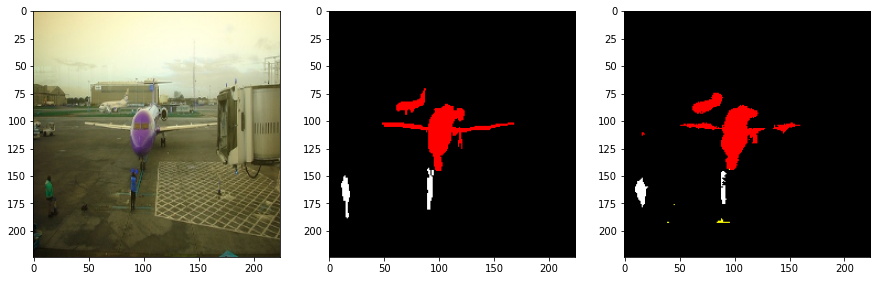

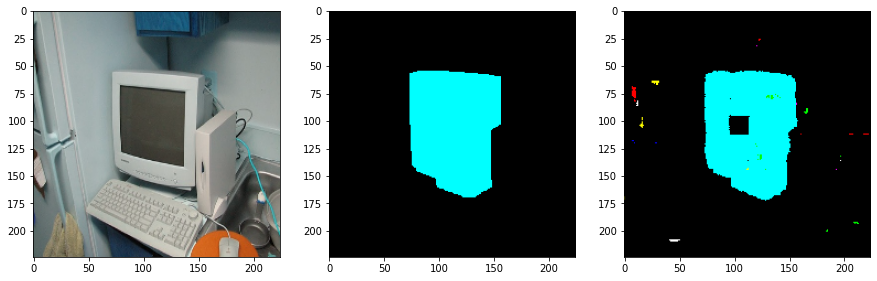

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


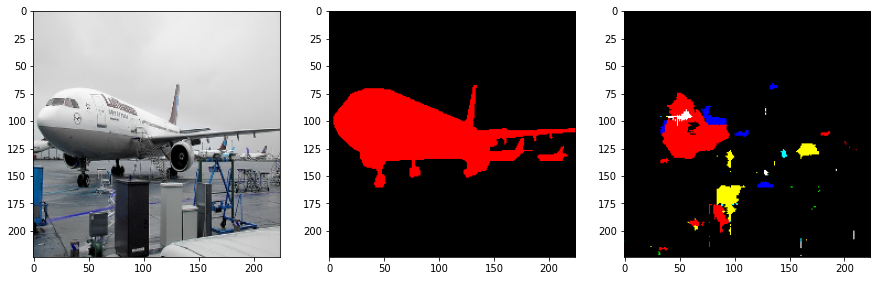

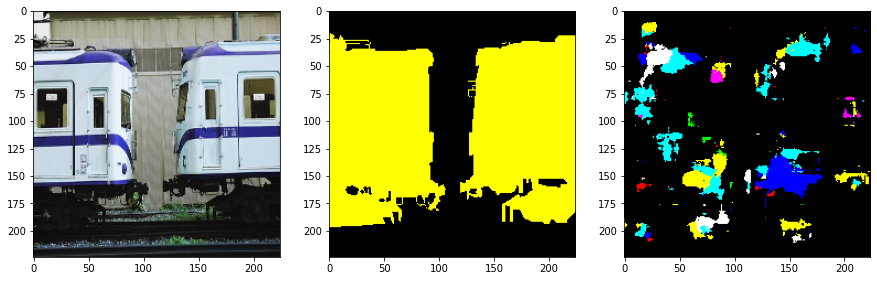

In [ ]:
skip = train(model_name="skip", criterionType="ce", num_epochs=200, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)
ind = range(0,2)
visualizePrediction(skip, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(skip, voc2012.val_images[ind], voc2012.val_labels[ind])

Model Architecture to be Trained: 
FCN(
  (pool4): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


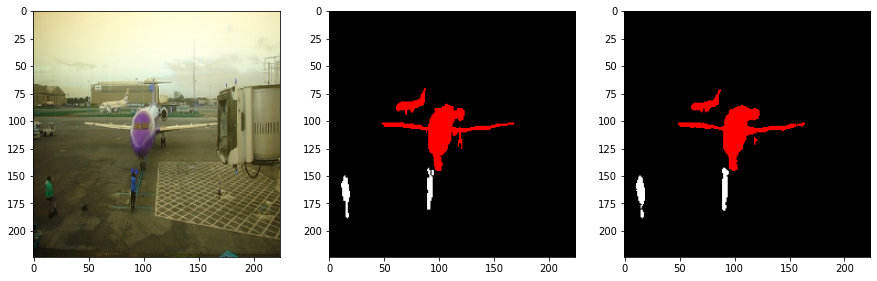

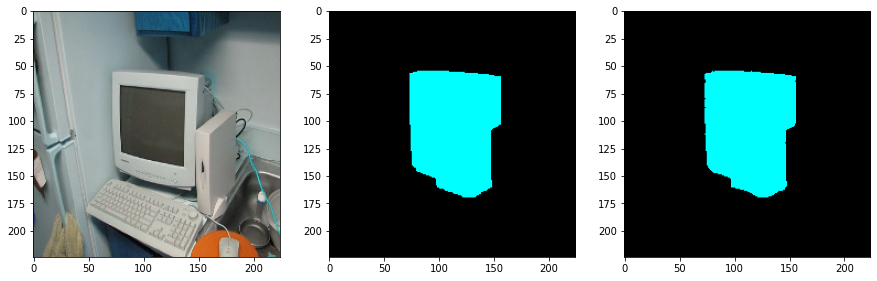

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


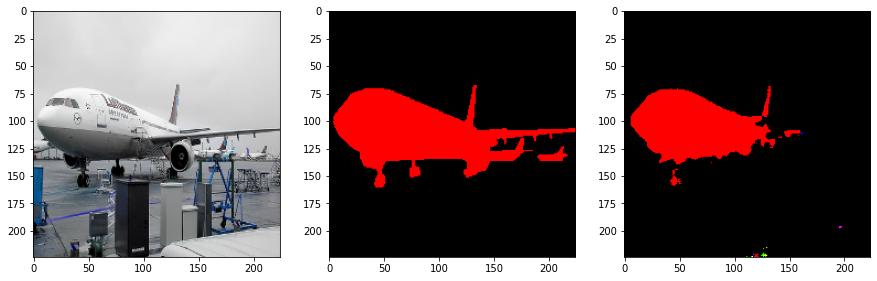

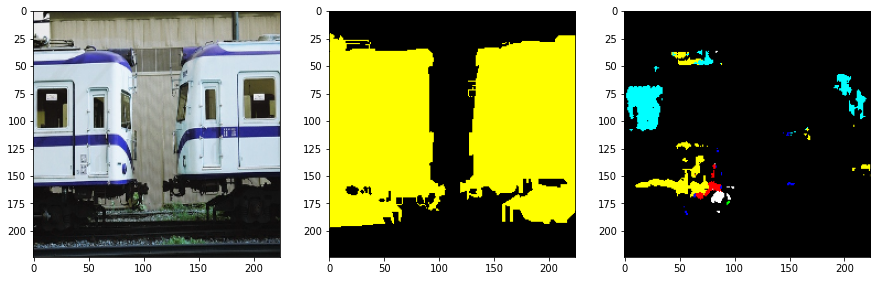

In [14]:
fcn = train(model_name="fcn", criterionType="ce", num_epochs=200, batch_size=4, learning_rate=1e-4, weight_decay=1e-5)
ind = range(0,2)
visualizePrediction(fcn, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(fcn, voc2012.val_images[ind], voc2012.val_labels[ind])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

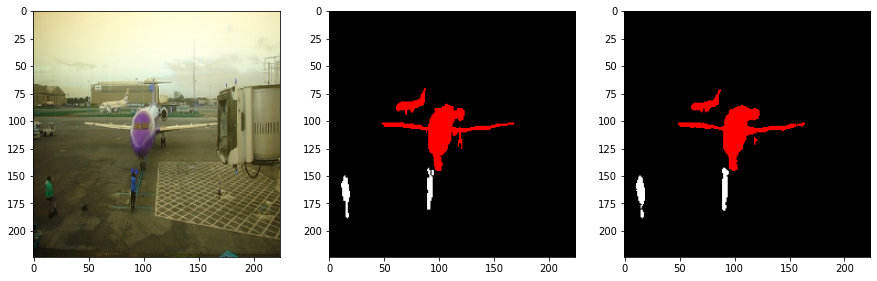

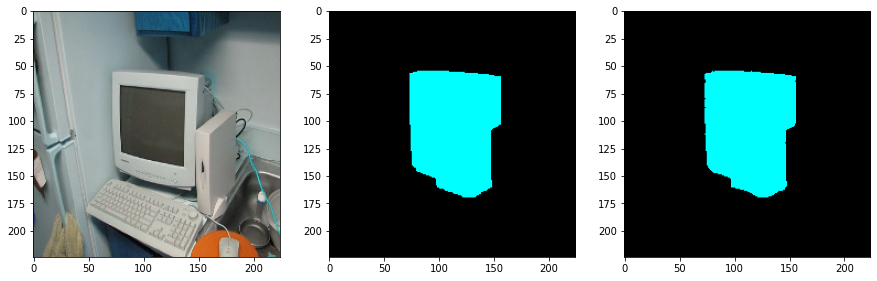

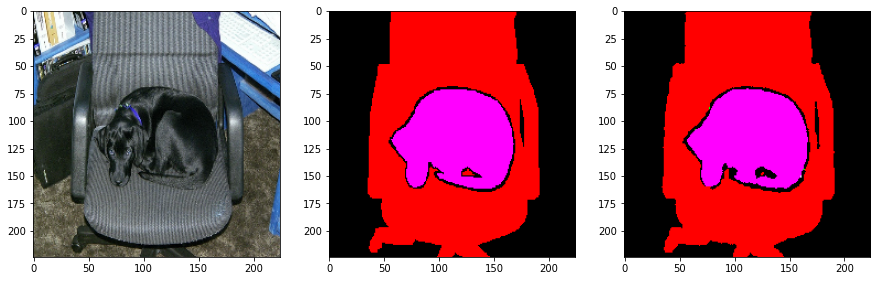

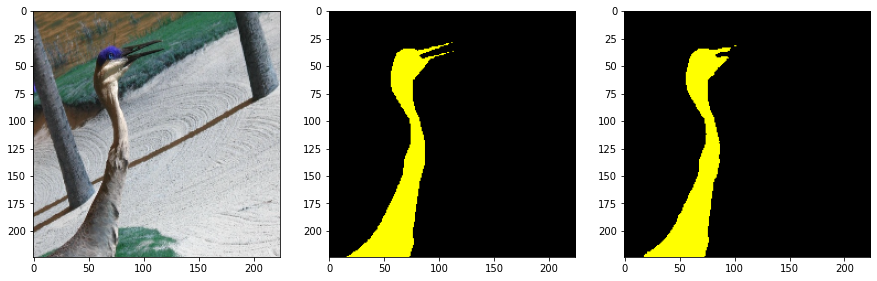

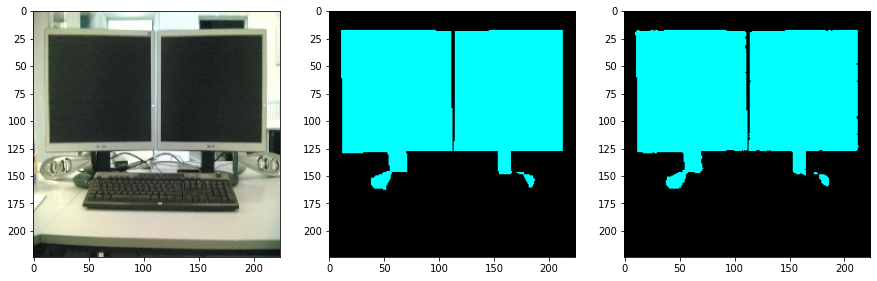

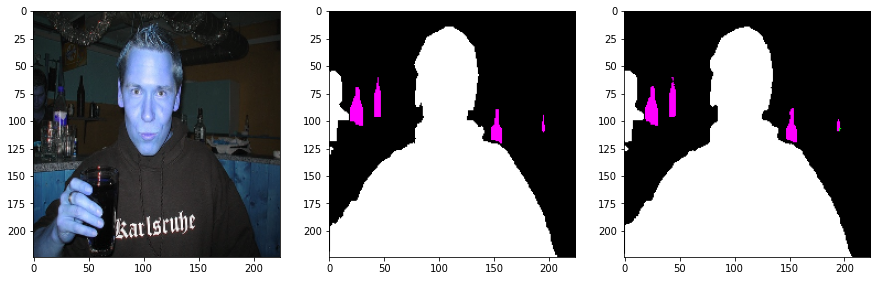

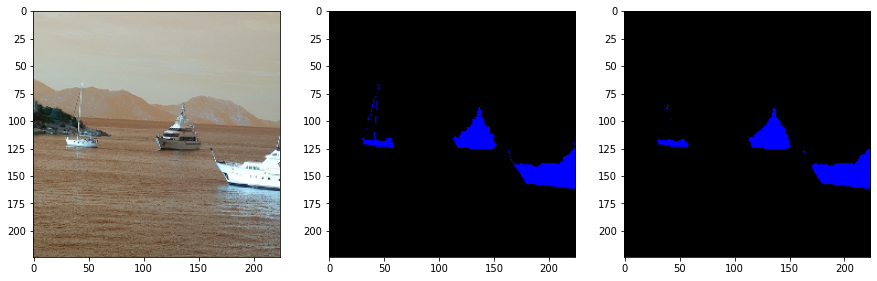

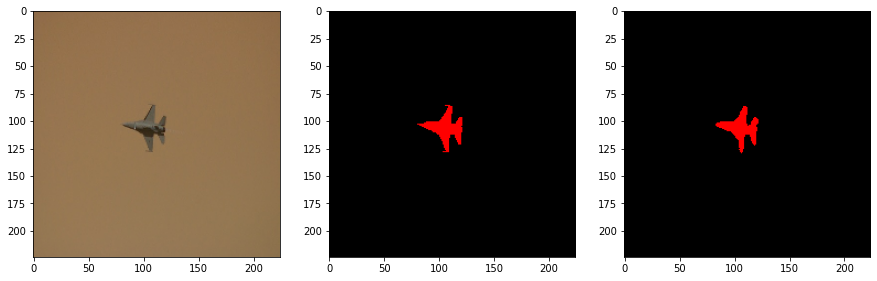

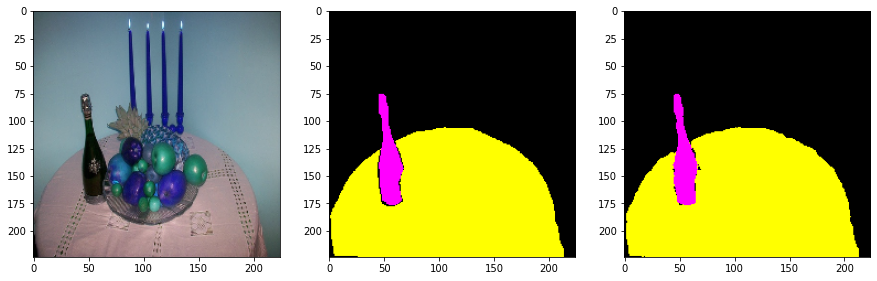

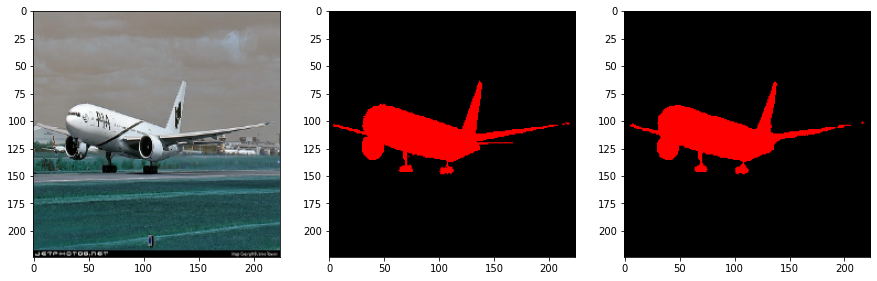

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

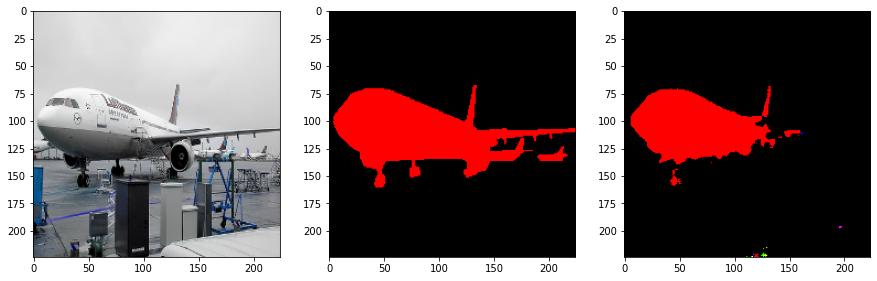

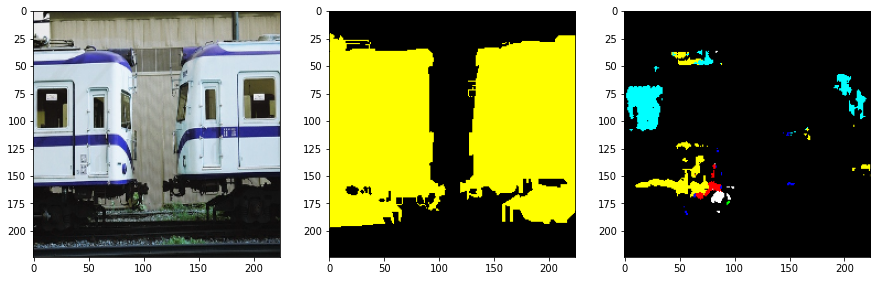

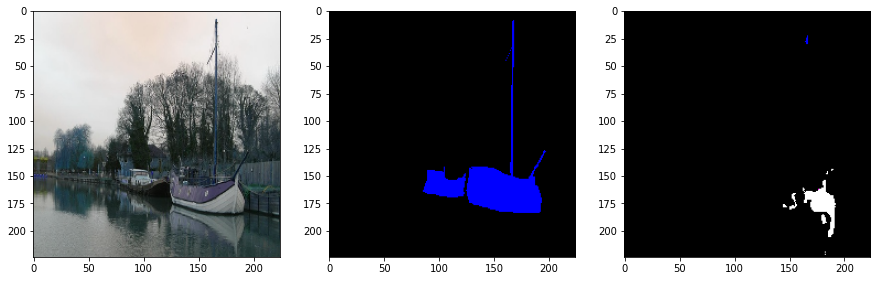

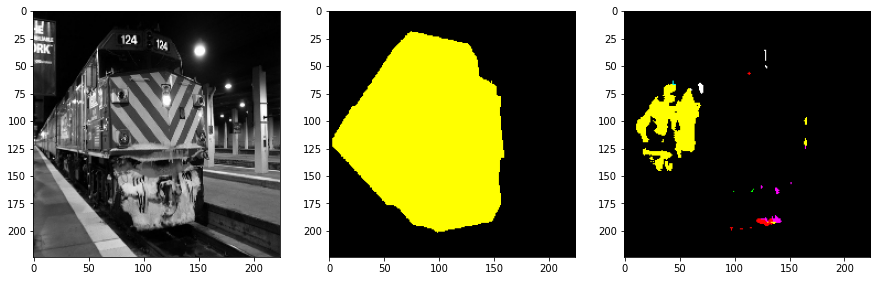

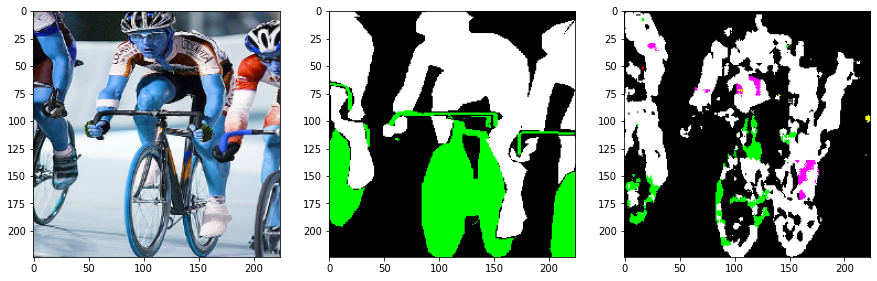

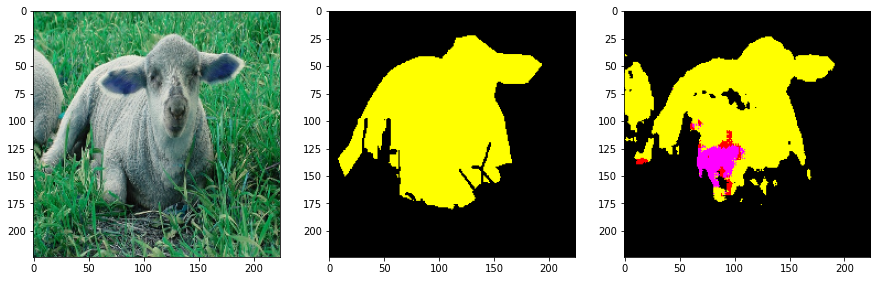

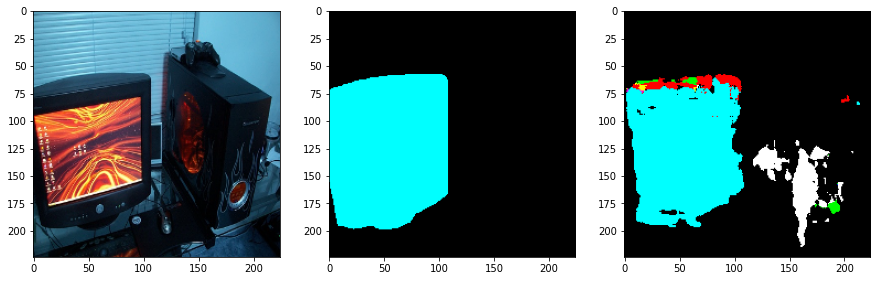

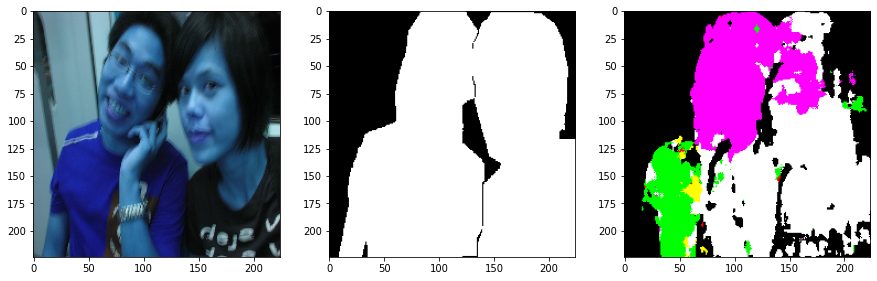

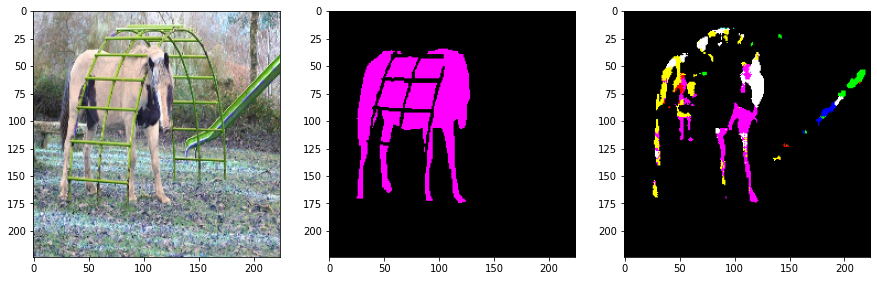

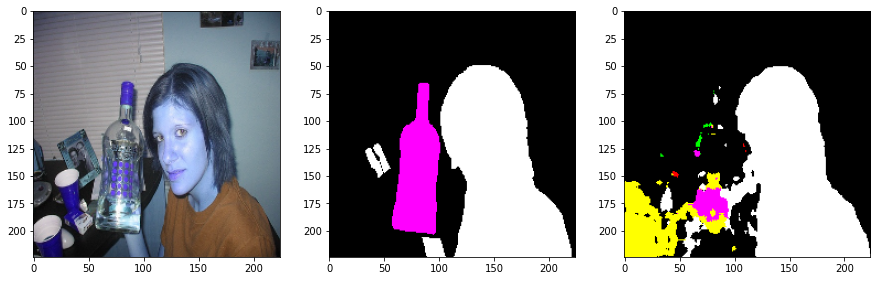

In [15]:
ind = range(0,10)
visualizePrediction(fcn, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(fcn, voc2012.val_images[ind], voc2012.val_labels[ind])

Model Architecture to be Trained: 
FCN8(
  (pool3): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

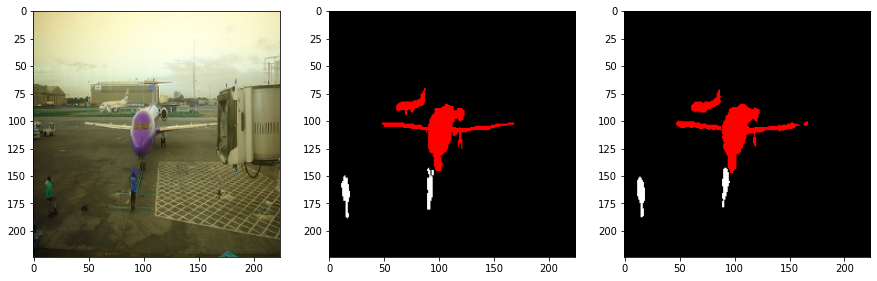

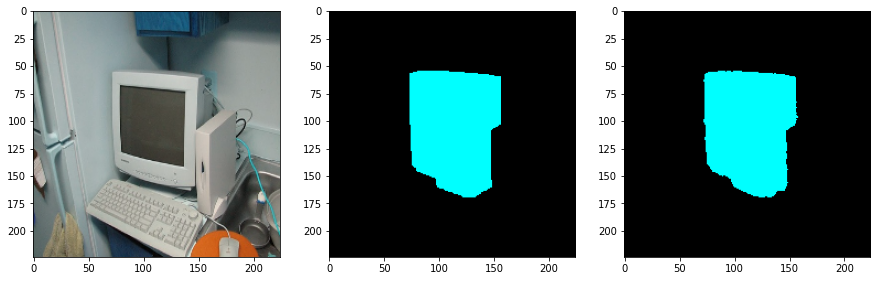

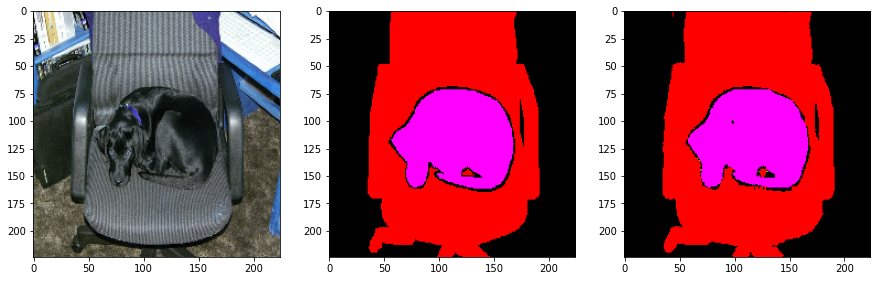

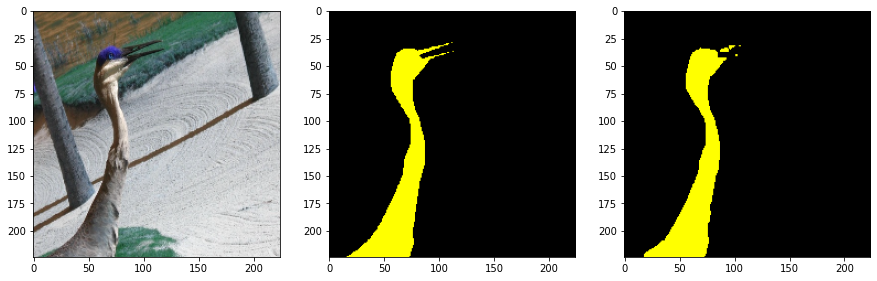

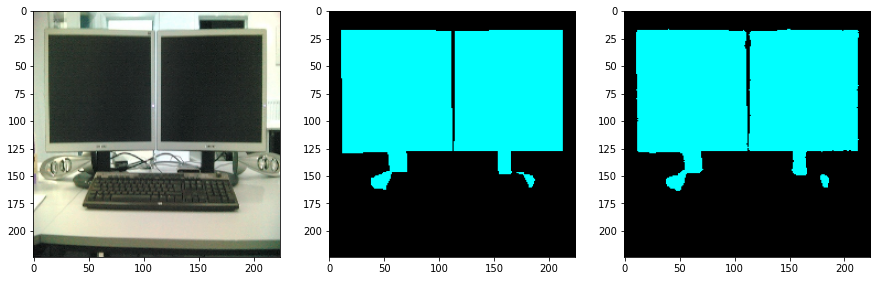

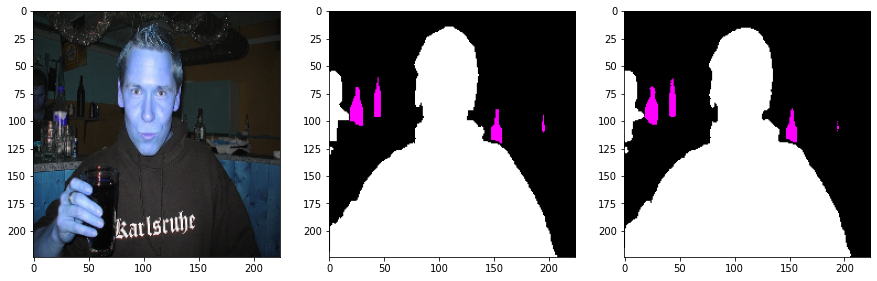

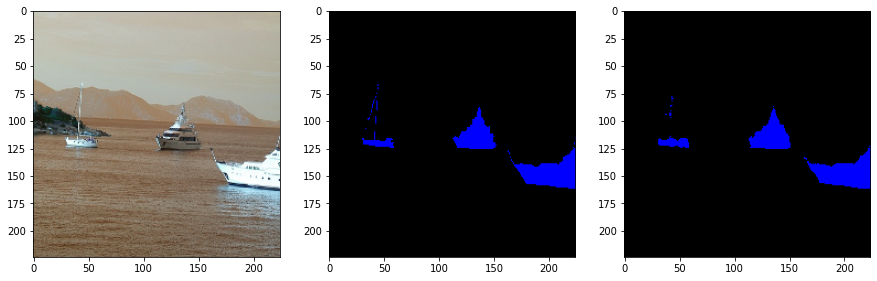

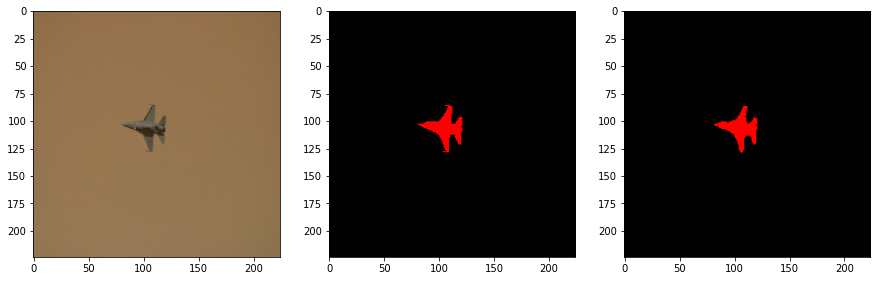

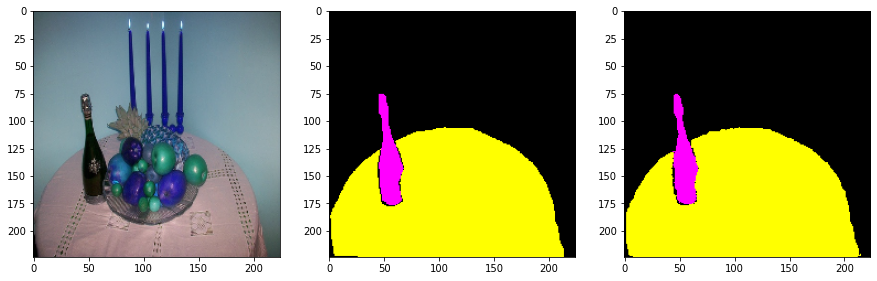

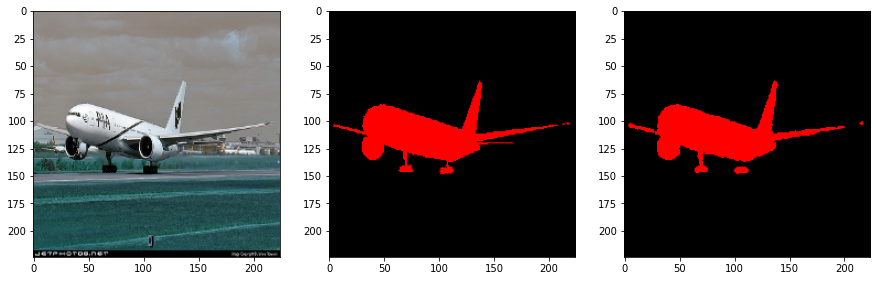

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

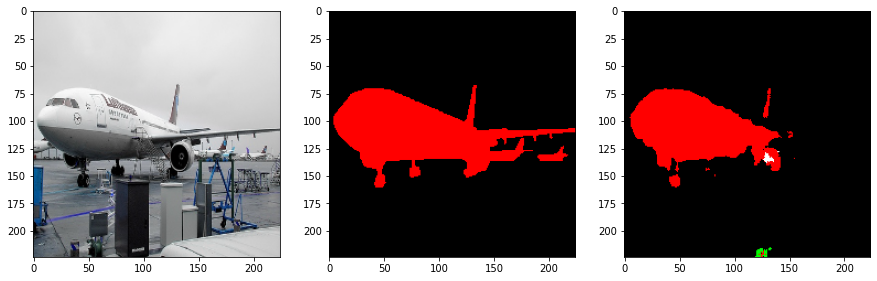

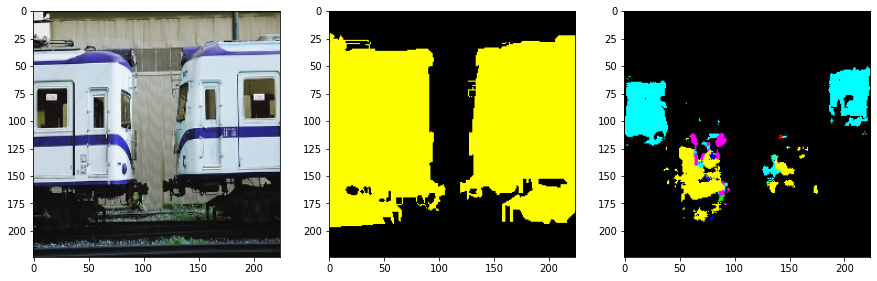

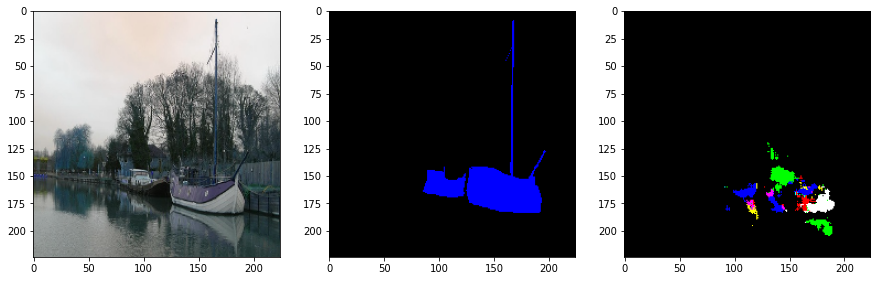

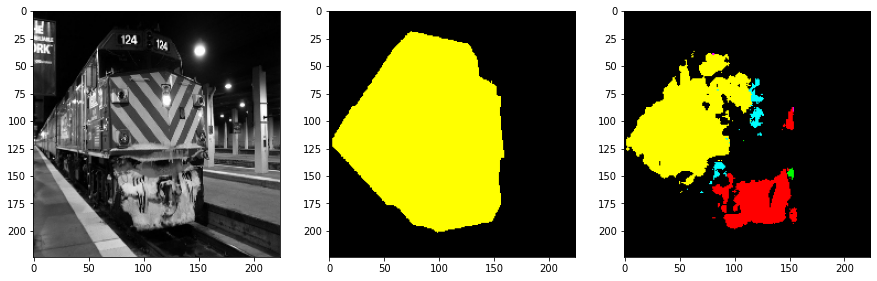

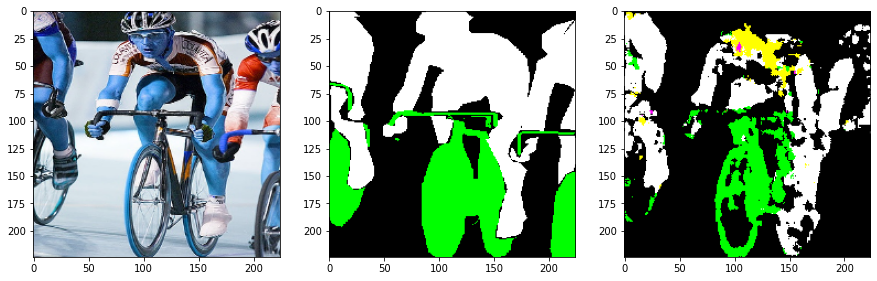

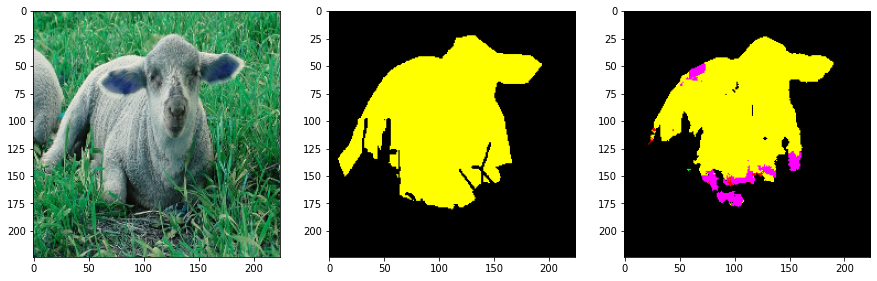

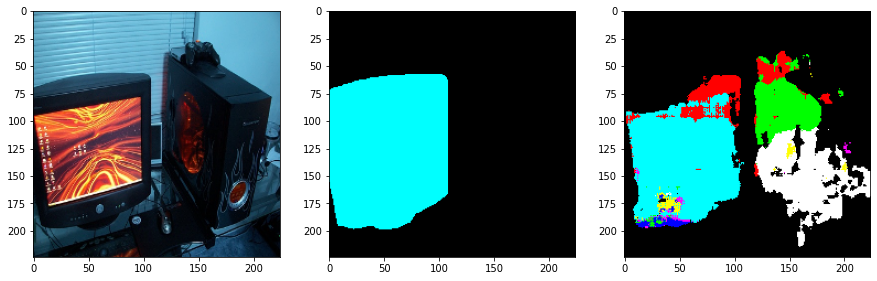

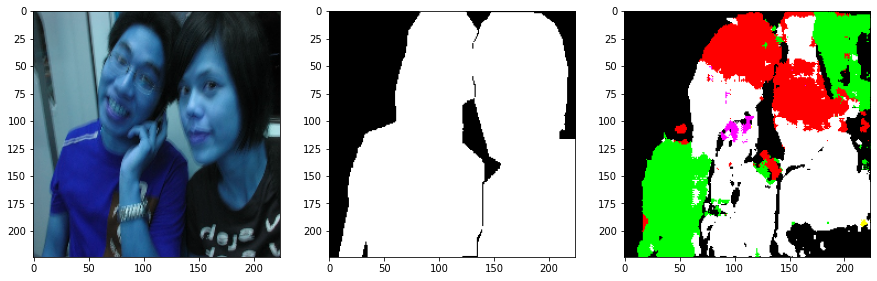

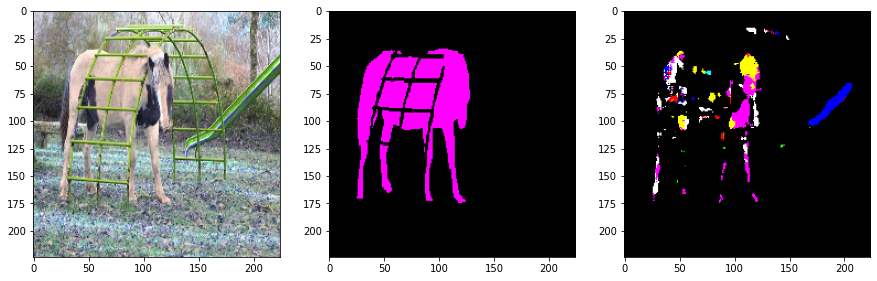

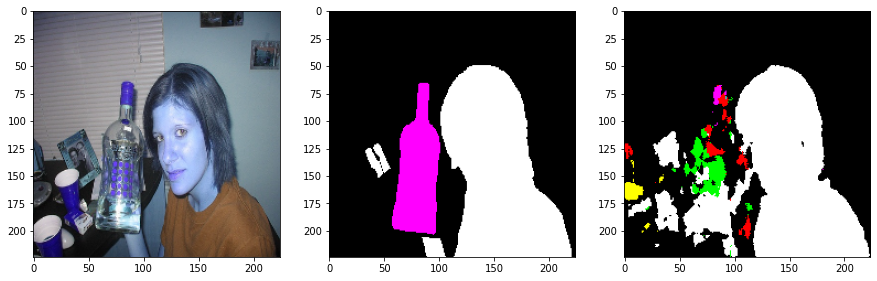

In [16]:
fcn8 = train(model_name="fcn8", criterionType="ce", num_epochs=200, batch_size=4, learning_rate=1e-4, weight_decay=1e-5)
ind = range(0,10)
visualizePrediction(fcn8, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(fcn8, voc2012.val_images[ind], voc2012.val_labels[ind])

In [ ]:
# torch.save(fcn.state_dict(), "./fcn_200.pt")
torch.save(fcn, "./fcn_200_freez.pt")


In [ ]:
from unet import UNet
unet = UNet(21)
train(unet, voc2012, model_name="unet", weighted=False, ignore=False, num_epochs=100, batch_size=10, learning_rate=1e-3, weight_decay=1e-5)

ind = range(0, 5)
print("Train")
visualizePrediction(unet, voc2012.train_images[ind], voc2012.train_labels[ind])
print("Test")
visualizePrediction(unet, voc2012.val_images[ind], voc2012.val_labels[ind])


Epoch:1, Loss:1.2841 
Epoch:2, Loss:1.2410 
Epoch:3, Loss:1.2249 
Epoch:4, Loss:1.2014 
Epoch:5, Loss:1.1753 
Epoch:6, Loss:1.1871 
Epoch:7, Loss:1.1466 
Epoch:8, Loss:1.1004 
Epoch:9, Loss:1.0717 


RuntimeError: ignored

In [ ]:
torch.save(unet, "./model/" + "unet_ce" + '.pt')


Train count:  1464
Val count:  1449
Train image:  (224, 224, 3)
Train label:  (224, 224)
Unique classes:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]


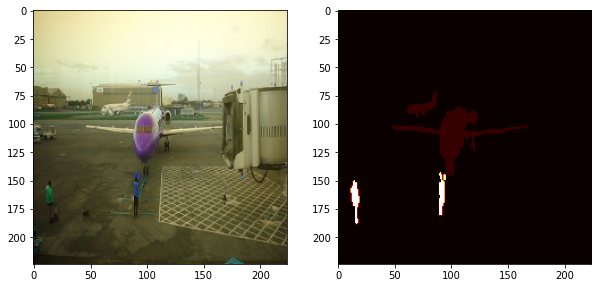

In [ ]:
print("Train count: ", len(voc2012.train_images))
print("Val count: ", len(voc2012.val_images))

print("Train image: ", voc2012.train_images[0].shape)
print("Train label: ", voc2012.train_labels[0].shape)

print("Unique classes: ", np.unique(voc2012.train_labels))


plt.subplots(1,2, figsize=(10,10)) # specifying the overall grid size


plt.subplot(1,2,1)    # the number of images in the grid is 5*5 (25)
plt.imshow(voc2012.train_images[0])

plt.subplot(1,2,2)    # the number of images in the grid is 5*5 (25)
plt.imshow(voc2012.train_labels[0], cmap='hot')

plt.show()


In [ ]:
skip = Skip()
train(skip, voc2012, model_name="skip", num_epochs=400, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)


Epoch:1, Loss:1.6451 
Epoch:2, Loss:1.5439 
Epoch:3, Loss:1.4775 
Epoch:4, Loss:1.4206 
Epoch:5, Loss:1.4262 
Epoch:6, Loss:1.3876 
Epoch:7, Loss:1.3702 
Epoch:8, Loss:1.4015 
Epoch:9, Loss:1.3798 


AttributeError: ignored

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


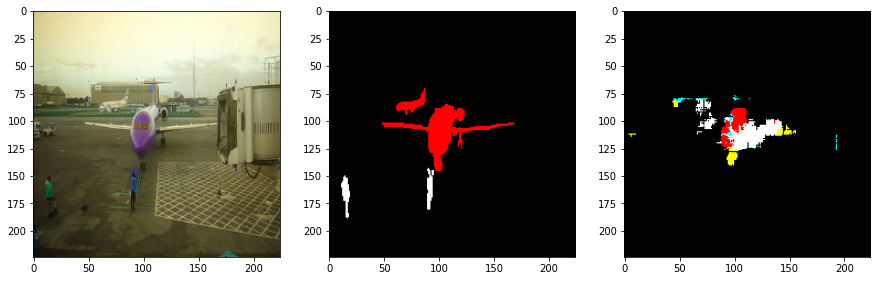

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


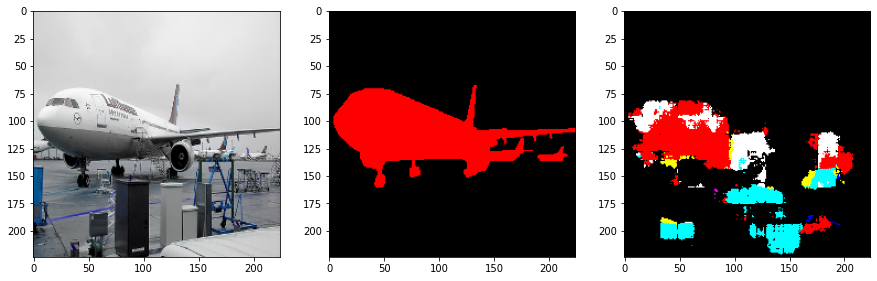

In [ ]:
ind = 0
visualizePrediction(skip, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(skip, voc2012.val_images[ind], voc2012.val_labels[ind])

In [ ]:
# Naive model training 

naive = Naive()
train(naive, voc2012, model_name="naive", num_epochs=200, batch_size=128, learning_rate=1e-3, weight_decay=1e-5)


Epoch:1, Loss:1.8929 
Epoch:2, Loss:1.6267 
Epoch:3, Loss:1.4424 
Epoch:4, Loss:1.4947 
Epoch:5, Loss:1.4426 
Epoch:6, Loss:1.4721 
Epoch:7, Loss:1.4069 
Epoch:8, Loss:1.4272 
Epoch:9, Loss:1.4488 
Epoch:10, Loss:1.4306 Val set: Average loss: 0.0203, Accuracy: 0/256 (0%)
Epoch:11, Loss:1.2843 
Epoch:12, Loss:1.2798 
Epoch:13, Loss:1.2834 
Epoch:14, Loss:1.2626 
Epoch:15, Loss:1.2568 
Epoch:16, Loss:1.2528 
Epoch:17, Loss:1.2488 
Epoch:18, Loss:1.2544 
Epoch:19, Loss:1.2415 
Epoch:20, Loss:1.2329 Val set: Average loss: 0.0189, Accuracy: 0/256 (0%)
Epoch:21, Loss:1.2332 
Epoch:22, Loss:1.2267 
Epoch:23, Loss:1.2123 
Epoch:24, Loss:1.1927 
Epoch:25, Loss:1.1864 
Epoch:26, Loss:1.1616 
Epoch:27, Loss:1.1685 
Epoch:28, Loss:1.1356 
Epoch:29, Loss:1.1292 
Epoch:30, Loss:1.1409 Val set: Average loss: 0.0180, Accuracy: 0/256 (0%)
Epoch:31, Loss:1.1262 
Epoch:32, Loss:1.1037 
Epoch:33, Loss:1.0936 
Epoch:34, Loss:1.0938 
Epoch:35, Loss:1.0685 
Epoch:36, Loss:1.0642 
Epoch:37, Loss:1.0824 
Epoch

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Naive(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): LeakyReLU(negative_slope=0.01)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout2d(p=0.5, inplace=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.01)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): Dropout2d(p=0.5, inplace=False)
    (12): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  )
  (decorder): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (1): L

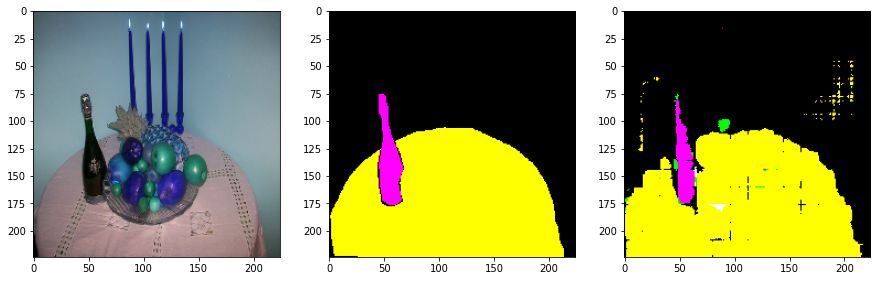

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


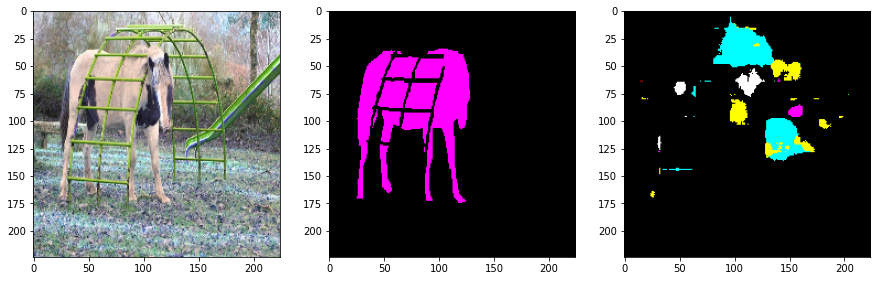

In [ ]:
ind = 8
visualizePrediction(naive, voc2012.train_images[ind], voc2012.train_labels[ind])
visualizePrediction(naive, voc2012.val_images[ind], voc2012.val_labels[ind])

In [ ]:
naive = Naive()
train(naive, voc2012, model_name="naive", weighted=True, num_epochs=200, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)

Epoch:1, Loss:2.5016 XXXVal set: Average loss: 0.0386, Accuracy: 0/256 (0%)
Epoch:2, Loss:2.3942 XXXVal set: Average loss: 0.0370, Accuracy: 0/256 (0%)
Epoch:3, Loss:2.3668 XXXVal set: Average loss: 0.0366, Accuracy: 0/256 (0%)
Epoch:4, Loss:2.3399 XXXVal set: Average loss: 0.0363, Accuracy: 0/256 (0%)
Epoch:5, Loss:2.3215 XXXVal set: Average loss: 0.0362, Accuracy: 0/256 (0%)
Epoch:6, Loss:2.3202 XXXVal set: Average loss: 0.0359, Accuracy: 0/256 (0%)
Epoch:7, Loss:2.2875 XXXVal set: Average loss: 0.0356, Accuracy: 0/256 (0%)
Epoch:8, Loss:2.2827 XXXVal set: Average loss: 0.0355, Accuracy: 0/256 (0%)
Epoch:9, Loss:2.2592 XXXVal set: Average loss: 0.0354, Accuracy: 0/256 (0%)
Epoch:10, Loss:2.2474 XXXVal set: Average loss: 0.0350, Accuracy: 0/256 (0%)
Epoch:11, Loss:2.2283 XXXVal set: Average loss: 0.0347, Accuracy: 0/256 (0%)
Epoch:12, Loss:2.2085 XXXVal set: Average loss: 0.0343, Accuracy: 0/256 (0%)
Epoch:13, Loss:2.1504 XXXVal set: Average loss: 0.0334, Accuracy: 0/256 (0%)
Epoch:14

KeyboardInterrupt: ignored

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

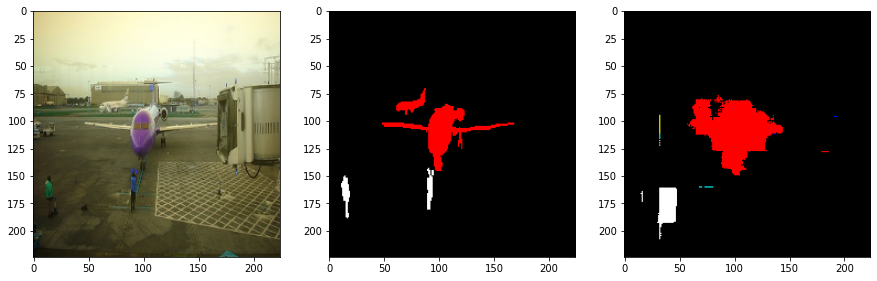

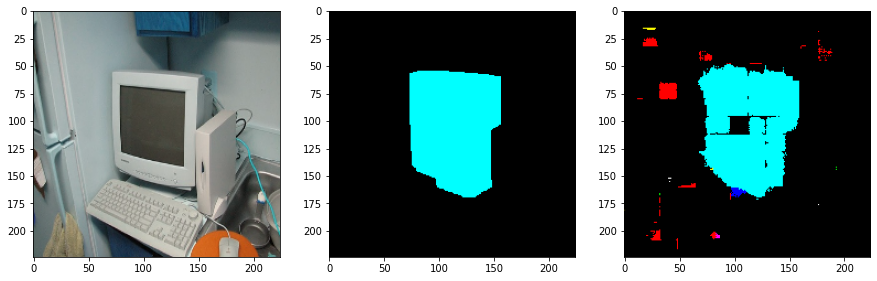

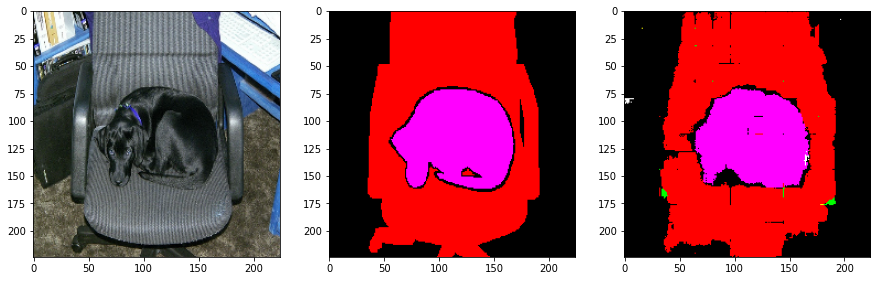

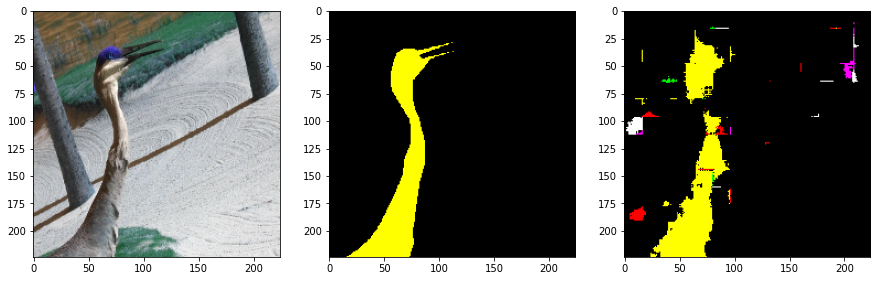

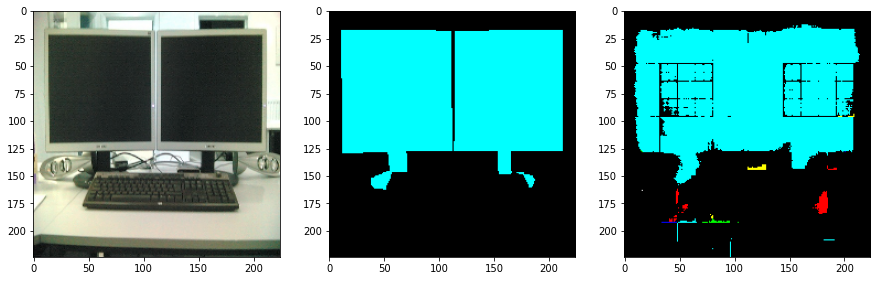

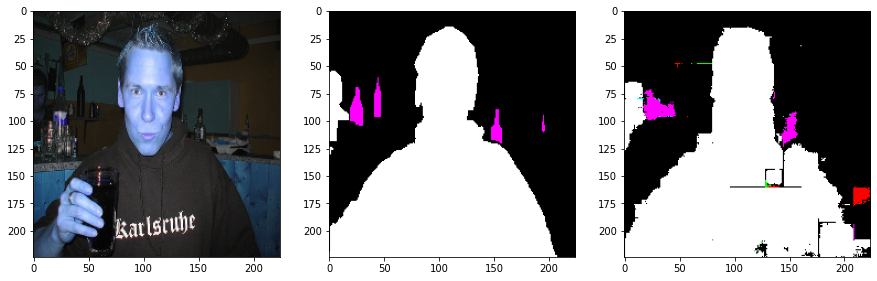

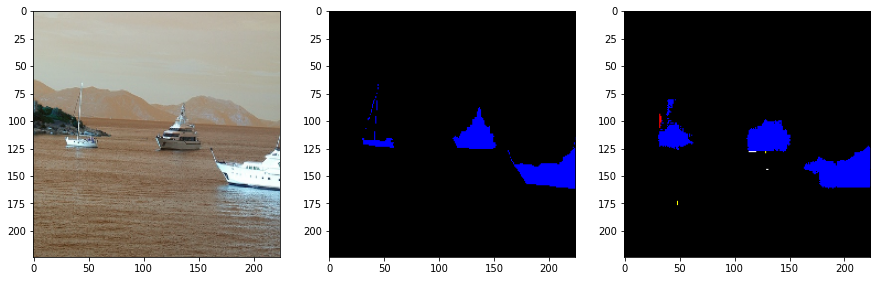

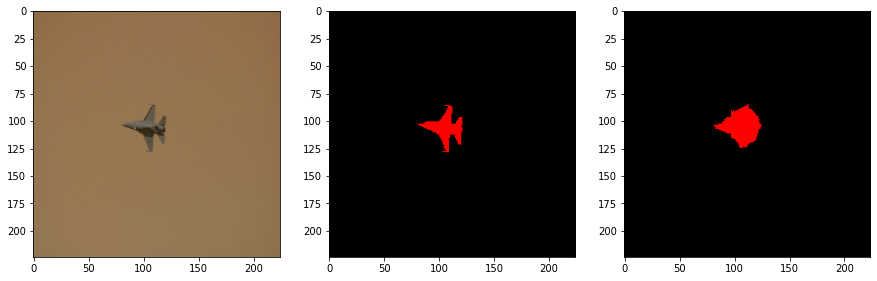

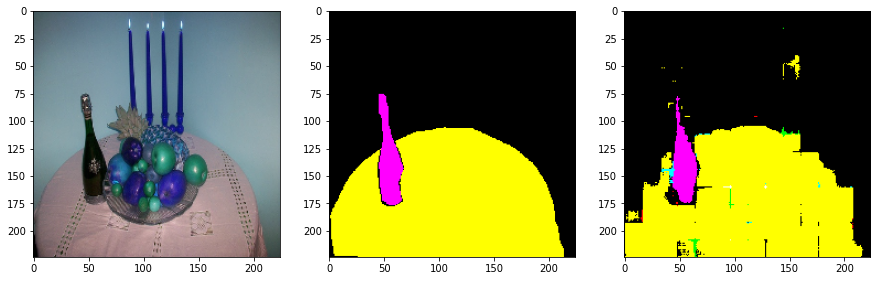

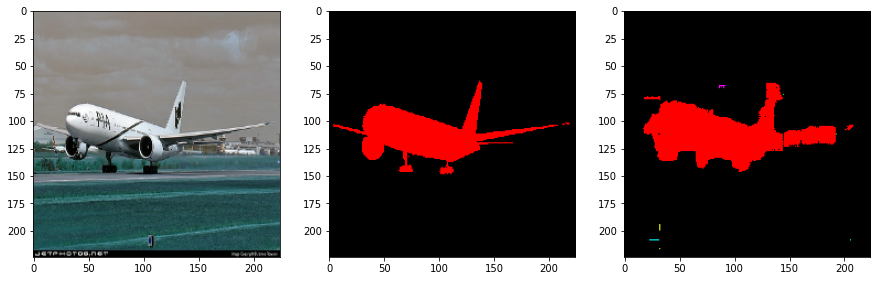

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

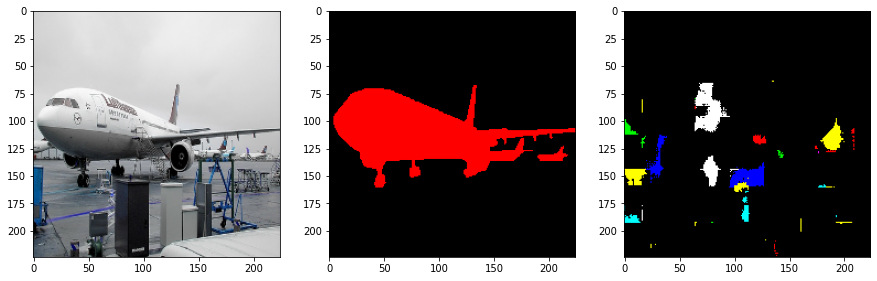

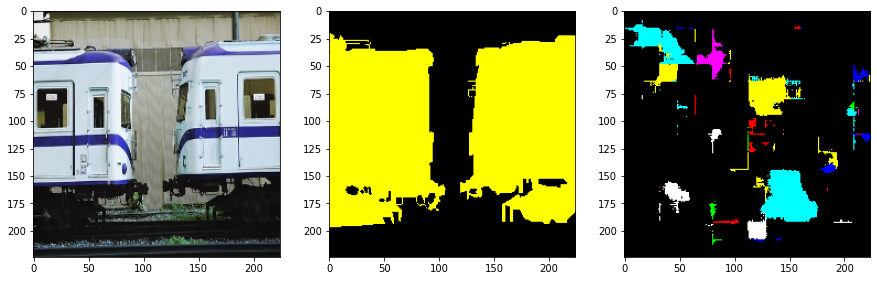

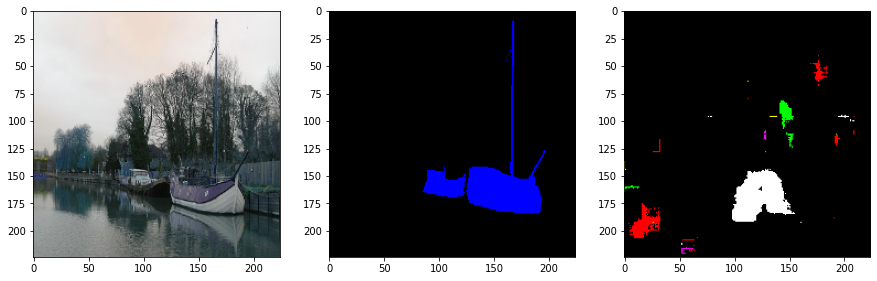

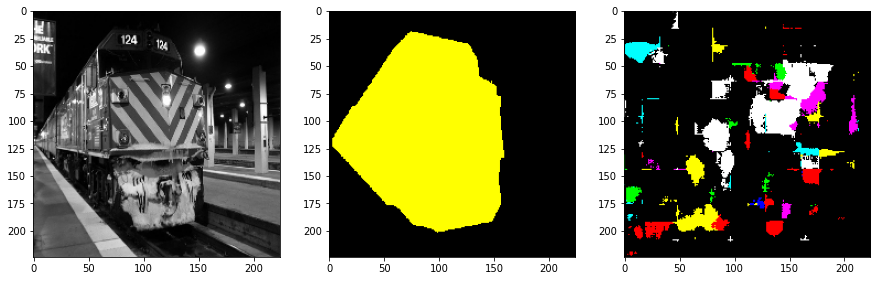

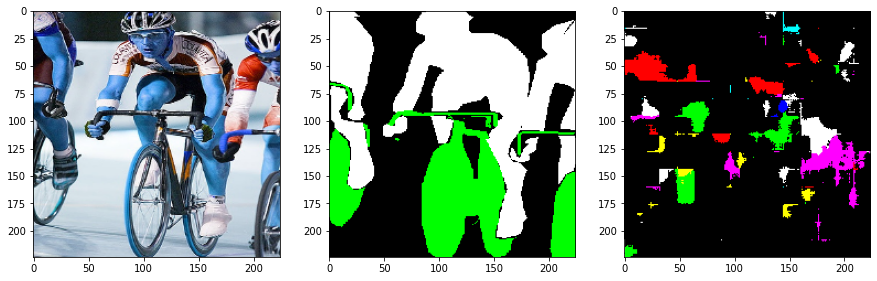

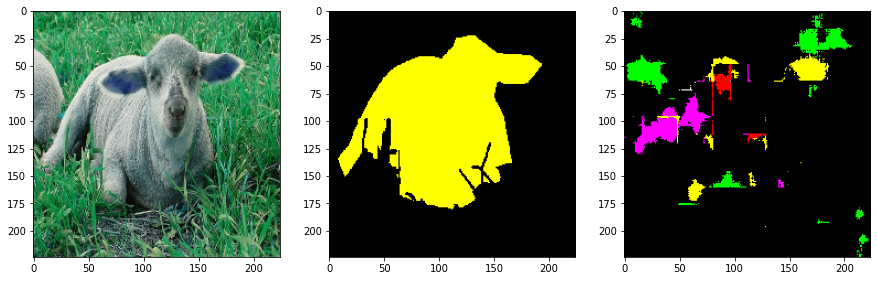

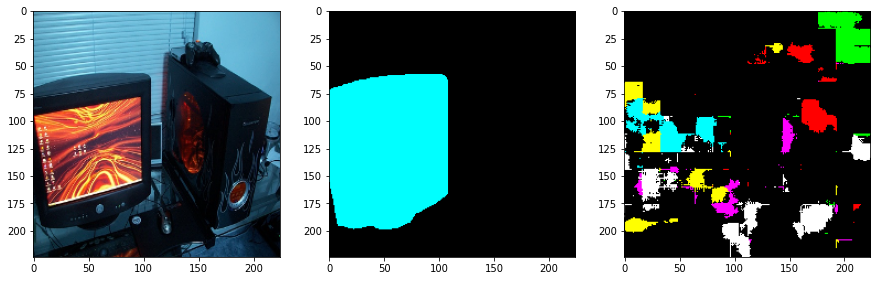

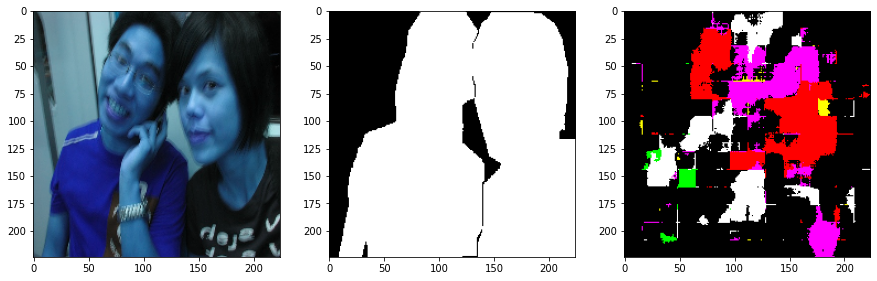

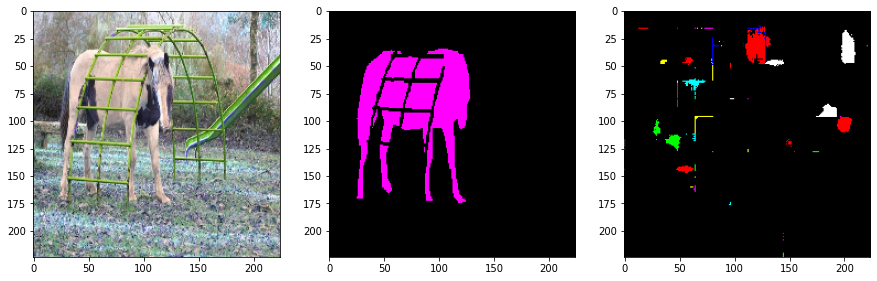

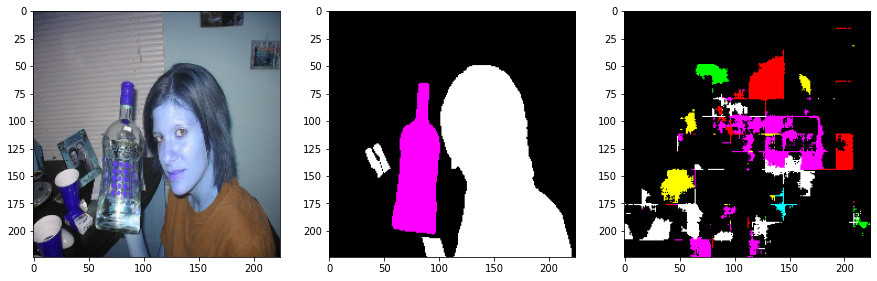

In [ ]:
ind = range(0, 10)

visualizePrediction(naive, voc2012.train_images[ind], voc2012.train_labels[ind])

visualizePrediction(naive, voc2012.val_images[ind], voc2012.val_labels[ind])

In [ ]:
naive = Naive()
train(naive, voc2012, model_name="naive", weighted=False, ignore=True, num_epochs=100, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)




Epoch:1, Loss:2.8937 XXXVal set: Average loss: 0.0468, Accuracy: 0/256 (0%)
Epoch:2, Loss:2.8069 XXXVal set: Average loss: 0.0452, Accuracy: 0/256 (0%)
Epoch:3, Loss:2.6663 XXXVal set: Average loss: 0.0451, Accuracy: 0/256 (0%)
Epoch:4, Loss:2.9175 XXXVal set: Average loss: 0.0457, Accuracy: 0/256 (0%)
Epoch:5, Loss:2.6060 XXXVal set: Average loss: 0.0435, Accuracy: 0/256 (0%)
Epoch:6, Loss:2.6550 XXXVal set: Average loss: 0.0445, Accuracy: 0/256 (0%)
Epoch:7, Loss:2.7723 XXXVal set: Average loss: 0.0440, Accuracy: 0/256 (0%)
Epoch:8, Loss:2.5518 XXXVal set: Average loss: 0.0435, Accuracy: 0/256 (0%)
Epoch:9, Loss:2.7174 XXXVal set: Average loss: 0.0436, Accuracy: 0/256 (0%)
Epoch:10, Loss:2.6332 XXXVal set: Average loss: 0.0433, Accuracy: 0/256 (0%)
Epoch:11, Loss:2.6054 XXXVal set: Average loss: 0.0431, Accuracy: 0/256 (0%)
Epoch:12, Loss:2.5656 XXXVal set: Average loss: 0.0427, Accuracy: 0/256 (0%)
Epoch:13, Loss:2.4504 XXXVal set: Average loss: 0.0476, Accuracy: 0/256 (0%)
Epoch:14

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Train


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

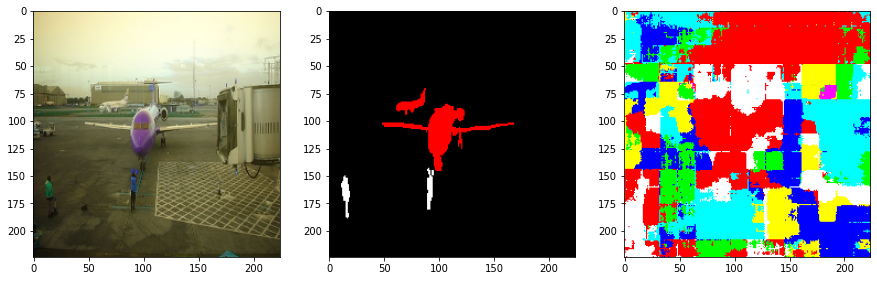

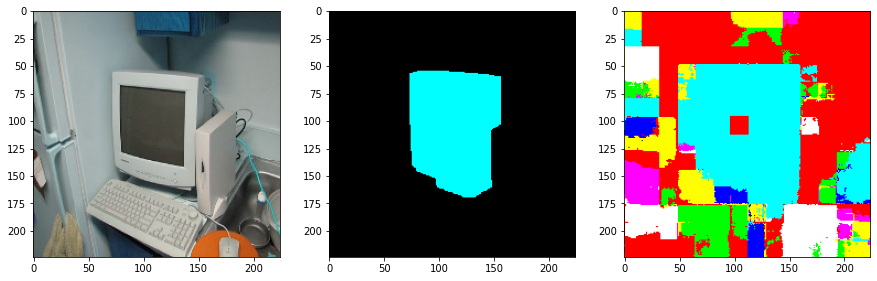

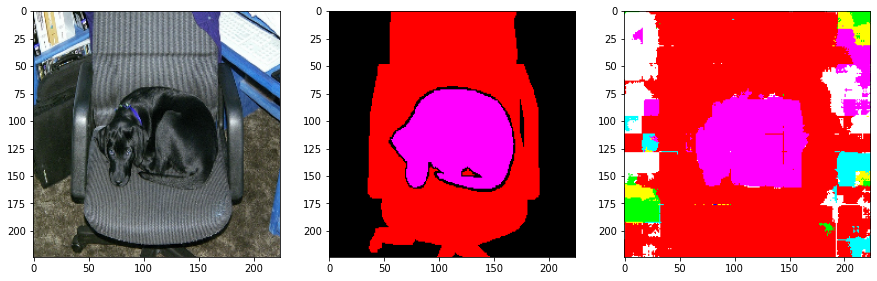

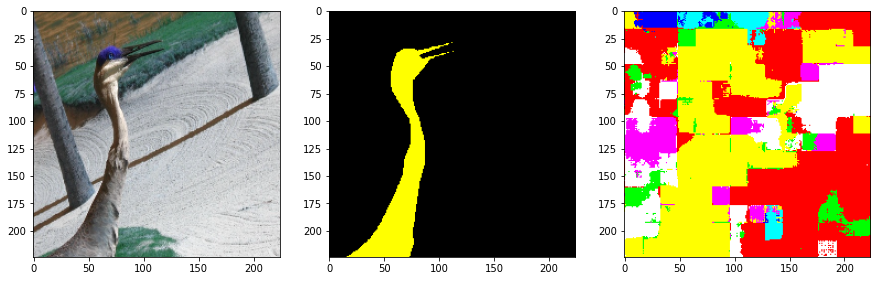

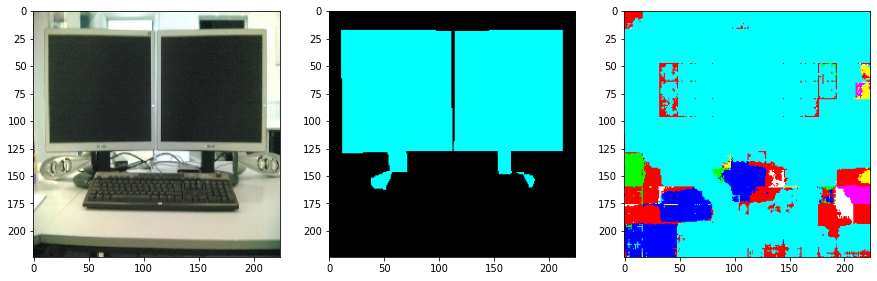

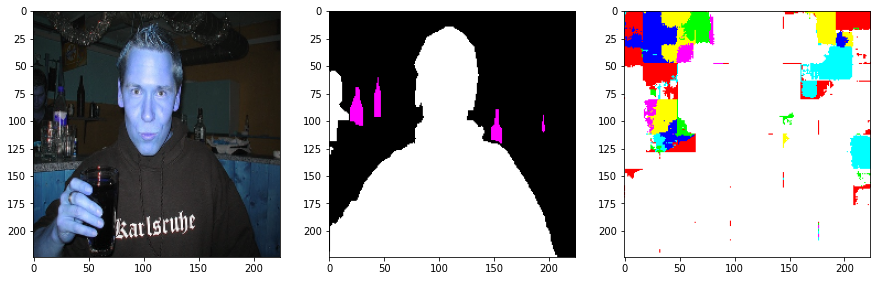

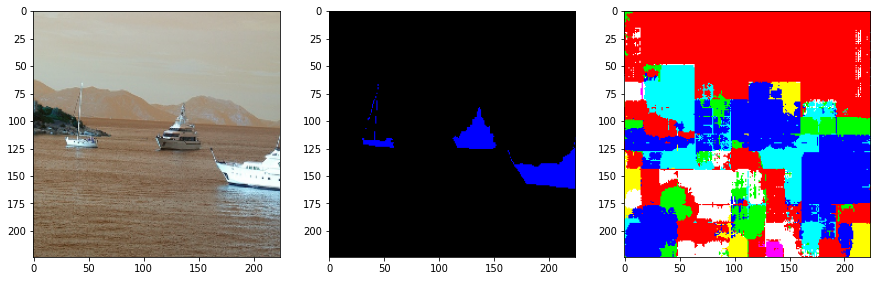

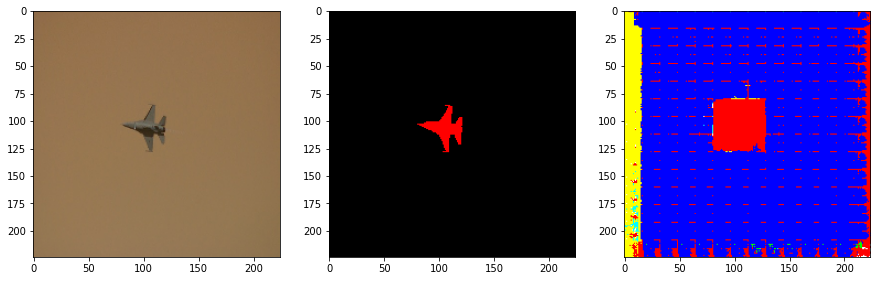

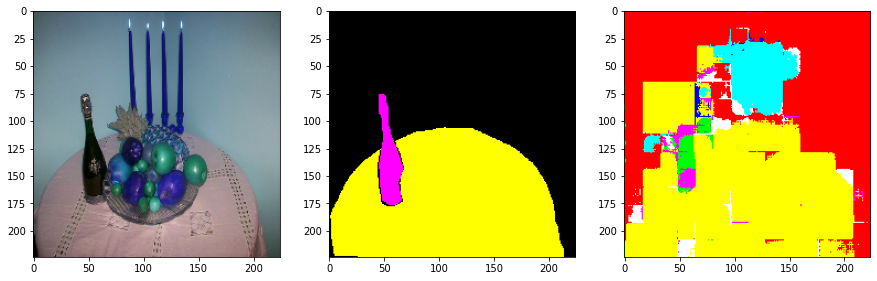

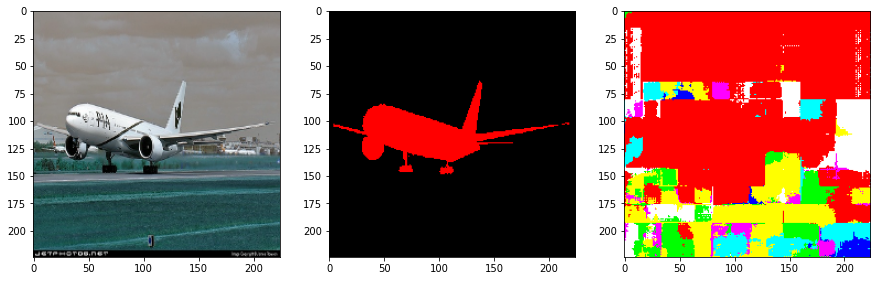

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

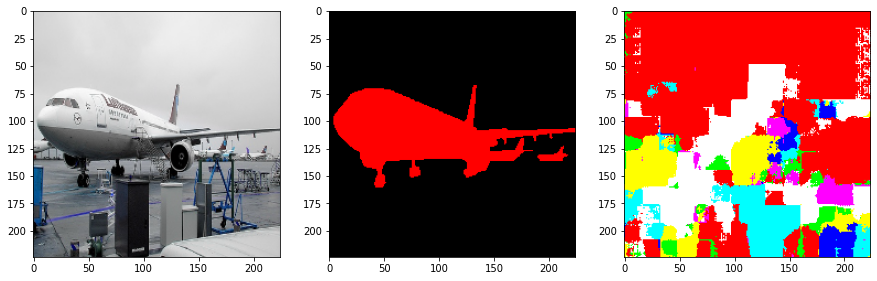

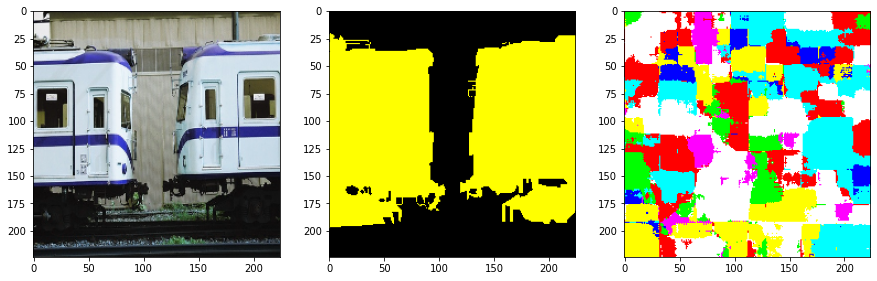

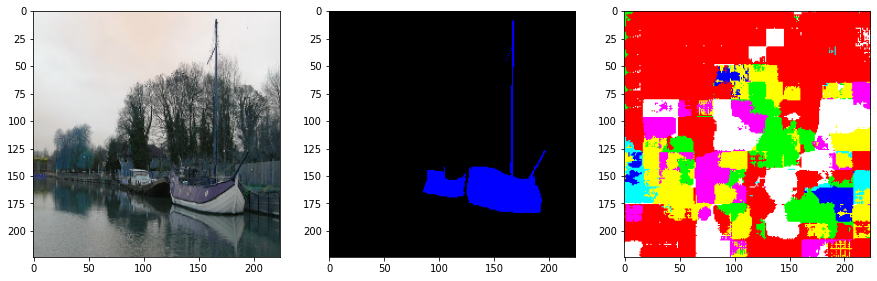

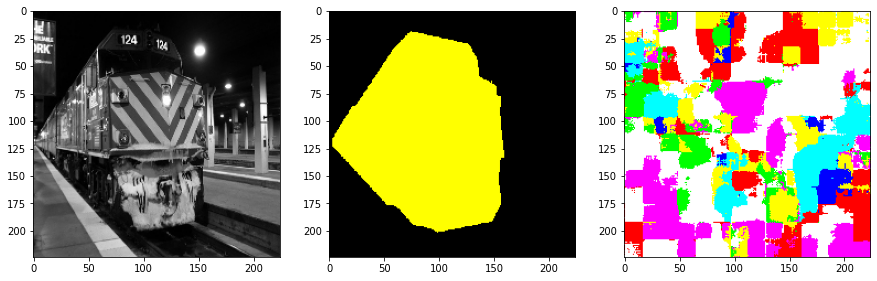

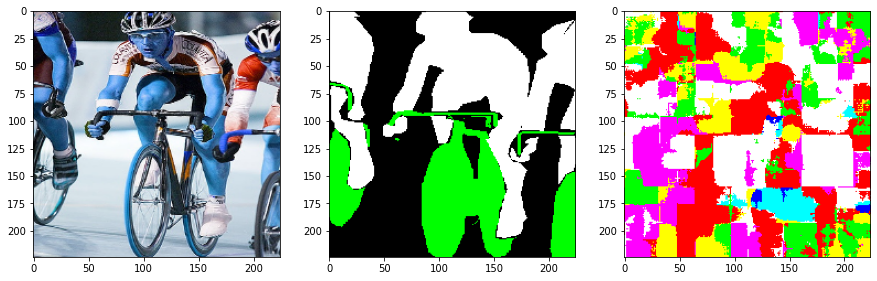

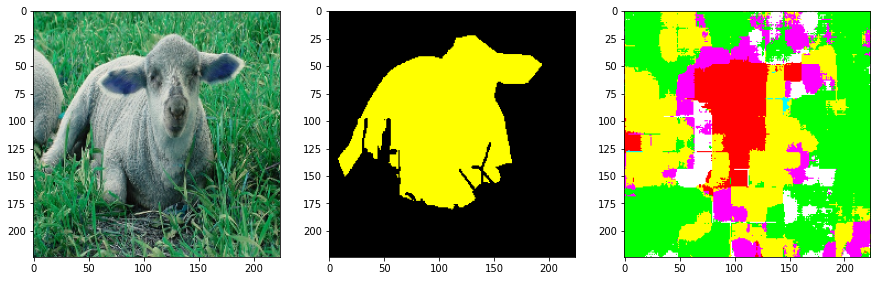

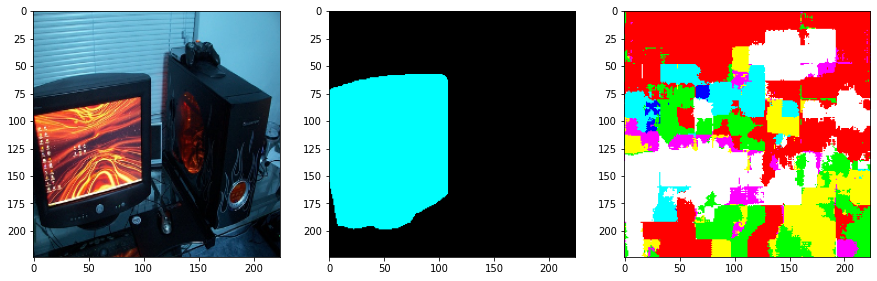

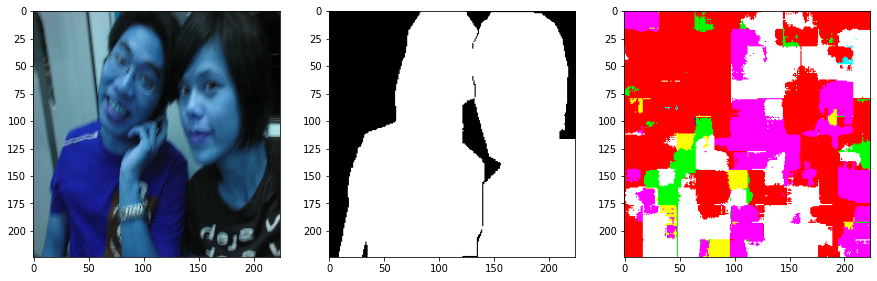

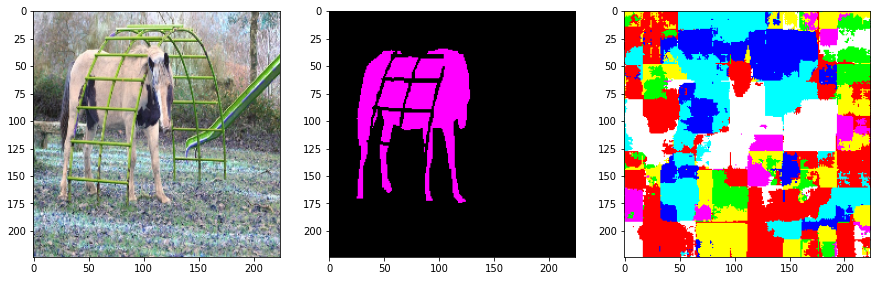

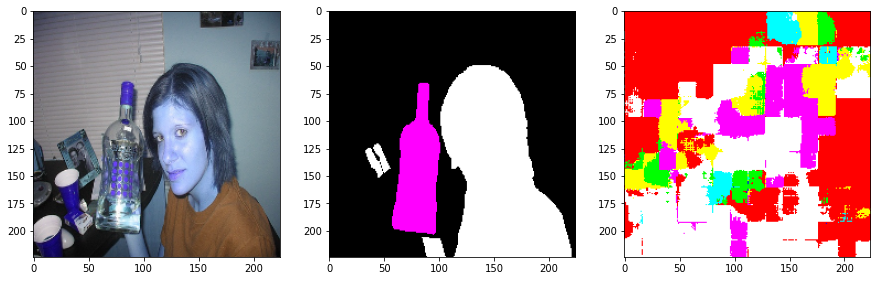

In [ ]:
ind = range(0, 10)
print("Train")
visualizePrediction(naive, voc2012.train_images[ind], voc2012.train_labels[ind])
print("Test")
visualizePrediction(naive, voc2012.val_images[ind], voc2012.val_labels[ind])

In [ ]:
!zip -r /content/model.zip /content/model

  adding: content/model/ (stored 0%)
  adding: content/model/Naive.py (deflated 71%)
  adding: content/model/naive_ce_weighted.pt (deflated 7%)
  adding: content/model/naive_ce_ignore.pt (deflated 8%)
  adding: content/model/naive.pt (deflated 7%)
  adding: content/model/naive_ce_ignore.log (deflated 85%)
  adding: content/model/__init__.py (stored 0%)
  adding: content/model/checkpoint/ (stored 0%)
  adding: content/model/checkpoint/naive_ce_weighted_e60.pt (deflated 7%)
  adding: content/model/checkpoint/naive_ce_ignore_e60.pt (deflated 7%)
  adding: content/model/checkpoint/naive_ce_weighted_e90.pt (deflated 7%)
  adding: content/model/checkpoint/naive_ce_ignore_e30.pt (deflated 7%)
  adding: content/model/checkpoint/naive_ce_ignore_e90.pt (deflated 8%)
  adding: content/model/checkpoint/naive_ce_weighted_e30.pt (deflated 7%)
  adding: content/model/checkpoint/.gitkeep (stored 0%)
  adding: content/model/__pycache__/ (stored 0%)
  adding: content/model/__pycache__/Naive.cpython-36.p

In [ ]:
!zip -r /content/model.zip /content/model

from google.colab import files
files.download("/content/model.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
unet = UNet(21)
train(unet, voc2012, model_name="unet", weighted=False, ignore=True, num_epochs=100, batch_size=64, learning_rate=1e-3, weight_decay=1e-5)

ind = range(0, 5)
print("Train")
visualizePrediction(naive, voc2012.train_images[ind], voc2012.train_labels[ind])
print("Test")
visualizePrediction(naive, voc2012.val_images[ind], voc2012.val_labels[ind])


RuntimeError: ignored

In [ ]:

naive = Naive()
optimizer = torch.optim.Adam(naive.parameters(), lr=1e-3, weight_decay=1e-5)
if torch.cuda.is_available():
    checkpoint = torch.load("./model/naive_ce.pt")
    start_epoch = checkpoint['epoch']
    naive.load_state_dict(checkpoint['state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer'])
else:
    checkpoint = torch.load("./model/naive_ce.pt")
    start_epoch = checkpoint['epoch']
    naive.load_state_dict(checkpoint['state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer'])
naive.eval()
print(naive)

Naive(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout2d(p=0.5, inplace=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): LeakyReLU(negative_slope=0.01)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout2d(p=0.5, inplace=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.01)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): Dropout2d(p=0.5, inplace=False)
    (12): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  )
  (decorder): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (1): L